# Helsingin Airbnb-markkinoiden analysointi

## Datasetin tuominen jupyteriin ja datasetin täydentäminen

Datasetti on kerätty scrapy-raapijalla Airbnb:n sivuilta, mutta valitettavasti osaa analyysissä käytettävistä tiedoista oli joko hanakalaa tai turhan aikaa vievää kerätä scrapylla - varsinkin kun joku on kirjoittanut kohtuullisen hyvän python paketin, joka osaa hakea tietoja Airbnb-asunnoista asuntokohtaisen id:n perusteella.

In [1]:

# Importing required libraries
import pandas as pd
import numpy as np
from numpy.random import seed
seed(123)
import matplotlib.pyplot as plt
%matplotlib inline
from datetime import datetime
import seaborn as sns
import geopandas as gpd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, cross_val_score
import xgboost as xgb
from xgboost import plot_importance
from sklearn.metrics import explained_variance_score, mean_squared_error, r2_score
import time
from keras import models, layers, optimizers, regularizers
from keras.utils.vis_utils import model_to_dot
from IPython.display import SVG
from statsmodels.tsa.seasonal import seasonal_decompose
from keras.utils.vis_utils import plot_model
import os
import warnings
warnings.filterwarnings("ignore")

import pandas as pd



Using TensorFlow backend.
/home/ari/Documents/Btsynced/opinnot/UTA/johdatusDatatieteeseen/joda-kev20/.venvEnv/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:516: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/ari/Documents/Btsynced/opinnot/UTA/johdatusDatatieteeseen/joda-kev20/.venvEnv/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:517: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/ari/Documents/Btsynced/opinnot/UTA/johdatusDatatieteeseen/joda-kev20/.venvEnv/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:518: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a f

Koska osaa tiedoista vielä täydennetään, otan käyttöön tietokannan, josta pystyn tehokkaasti tarkistamaan, onko tietty tieto jo tallennettu tietystä asunnosta, jolloin en joudu hakemaan samaa tietoa enää uudelleen. Toisaalta tämä myös helpottaa historiatietojen keräämistä markkinoista, mikäli niitä hyödyntäväiä ominaisuuksia haluttaisiin myöhemmin implementoida.


Mikäli haluat hyödyntää tätä jupyter notebookia, voit joko asentaa vaaditut python paketit ajamalla python -r install requirements.txt tai ottaa kommenttimerkit pois seuraavista soluista, joiden pitäisi riittää mahdollistamaan tämän notebookin toiminta. Paketit kannattaa kuitenkin asentaa omaan virtualenv:hensä tms., mihin löydät ohjeet [githubistani](https://github.com/attkauppi/joda) tai googlettamalla.

In [2]:
import dataset
db = dataset.connect("sqlite:///home/ari/Documents/Btsynced/opinnot/UTA/johdatusDatatieteeseen/joda-kev20/data/helsinki-instant.db")

db.close()

In [3]:
# %load basic_installs.py
import sys
#!{sys.executable} -m pip install geopandas
#!{sys.executable} -m pip install mplleaflet
#!{sys.executable} -m pip install bs4
#!{sys.executable} -m pip install geocoder
#!{sys.executable} -m pip install geopy
#!{sys.executable} -m pip install folium
#!{sys.executable} -m pip install lxml
#!{sys.executable} -m pip install pygeoj
#!{sys.executable} -m pip install pyshp
###!{sys.executable} -m pip install datetime
#!{sys.executable} -m pip install seaborn
#!{sys.executable} -m pip install --upgrade cython

In [4]:
#!{sys.executable} -m pip install lxml
#mplleaflet bs4 geocoder geopy  folium  lxml pygeoj

In [5]:

# required package for timeseries
#!{sys.executable} -m pip install statsmodels

In [6]:
#!{sys.executable} -m pip install geopandas
#!{sys.executable} -m pip install descartes
#!{sys.executable} -m pip install requests

In [7]:
# requiered packages for accessibility analysis
# Make sure Cython is upgraded FIRST!
#!{sys.executable} -m pip install pandana

In [8]:
#!{sys.executable} -m pip install xgboost

In [9]:

main_file_path = 'data/amenities_columns_added.csv' 
raw_df = pd.read_csv(main_file_path, low_memory=False)

raw_df['host_id'] = np.nan
raw_df['member_since'] = '' 

#print(data.columns)

In [10]:
pd.set_option('display.max_columns', len(raw_df.columns)) # To view all columns
pd.set_option('display.max_rows', 100)

In [11]:
raw_df.head()

,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,True,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,NaN,False,22858494,False,False,False,Entire apartment,NaN,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,NaN,NaN,2,17,"Wifi,Kitchen,Heating",NaN,$38,1.0,nightly,NaN,NaN,NaN,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,NaN,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,NaN,
1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,False,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,NaN,False,16501244,False,False,True,Entire condominium,NaN,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,NaN,NaN,7,22,"Wifi,Kitchen,Heating",NaN,$58,37.0,nightly,NaN,NaN,NaN,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,NaN,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,NaN,
2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",NaN,4.80,1.0,1 bedroom,1.0,4.0,True,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,NaN,False,35440127,False,False,True,Entire apartment,NaN,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,NaN,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,NaN,NaN,NaN,6,13,"Wifi,Kitchen,Heating",NaN,$42,1.0,nightly,NaN,NaN,NaN,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,NaN,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,NaN,
3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,True,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,NaN,False,28982354,False,False,True,Shared room,NaN,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,NaN,NaN,3,3,"Wifi,Kitchen,Heating",NaN,$26,1.0,nightly,NaN,NaN,NaN,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,NaN,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,NaN,
4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,True,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,NaN,False,41969547,False,True,Fal

In [12]:
raw_df.isna().sum()

accuracy_rating                54
allows_children                18
allows_events                  18
allows_infants                 18
allows_pets                    18
allows_smoking                 18
amenity_ids                     1
available_30                  288
avg_rating                     60
bathrooms                       0
bedroom_label                   0
bedrooms                        1
beds                            6
can_instant_book                0
cancel_policy                   0
checkin_rating                 54
city                            0
cleaning_fee                    0
cleanliness_rating             54
communication_rating           54
guest_overall_satisfaction    288
host_verified                   0
id                              0
is_business_travel_ready        0
is_new_listing                  0
is_super_host                   0
kicker_content_message          0
latest_review                 288
latitude                        0
listing_url   

In [13]:
import sqlite3
# Create your connection.
cnx = sqlite3.connect(':memory:')

In [14]:
from sqlalchemy import create_engine

disk_engine = create_engine('sqlite:///data/helsinki-instant.db')

#raw_df.to_sql('raw3', disk_engine, if_exists='append')

In [15]:
e = create_engine('sqlite:///data/helsinki-instant.db')

In [16]:
raw_df = pd.read_sql_query('SELECT * FROM raw3',disk_engine)

In [17]:
df = pd.read_sql_query('SELECT * FROM raw3',disk_engine)
df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,...,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,...,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,None,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,...,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,None,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",23.0,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,...,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,None,None,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,...,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,None,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https://www

In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 288 entries, 0 to 287
Data columns (total 85 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   index                       288 non-null    int64  
 1   accuracy_rating             234 non-null    float64
 2   allows_children             270 non-null    float64
 3   allows_events               270 non-null    float64
 4   allows_infants              270 non-null    float64
 5   allows_pets                 270 non-null    float64
 6   allows_smoking              270 non-null    float64
 7   amenity_ids                 287 non-null    object 
 8   available_30                68 non-null     float64
 9   avg_rating                  228 non-null    float64
 10  bathrooms                   288 non-null    float64
 11  bedroom_label               288 non-null    object 
 12  bedrooms                    287 non-null    float64
 13  beds                        282 non

In [19]:
import re
import xgboost as xgb

import warnings
warnings.filterwarnings("ignore")

In [20]:
#%matplotlib inline

# general
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
#import matplotlib.pyplot as plt
%matplotlib inline

# Geographical analysis
import geopandas as gpf #libspatialindex nees to be installed first
import json # library to handle JSON files
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe
import shapefile as shp
import datetime
from statsmodels.tsa.seasonal import seasonal_decompose
import requests
import descartes

# accessibility analysis
import time
from pandana.loaders import osm
from pandana.loaders import pandash5

# modelling
from sklearn.preprocessing import StandardScaler, MinMaxScaler 
from sklearn.model_selection import train_test_split, cross_val_score 
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn import metrics
import xgboost as xgb
from xgboost import plot_importance
from sklearn.metrics import explained_variance_score, mean_squared_error, r2_score

#Hide warnings
import warnings
warnings.filterwarnings('ignore')

# Set plot preference
plt.style.use(style='ggplot')
plt.rcParams['figure.figsize'] = (10, 6)

print('Libraries imported.')
pd.set_option('display.max_columns', len(raw_df.columns)) # To view all columns
pd.set_option('display.max_rows', 100)

Libraries imported.


In [21]:
pd.set_option('display.max_columns', len(df.columns)) # To view all columns
pd.set_option('display.max_rows', 100)

In [22]:
raw_df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,None,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,None,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",23.0,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,6,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,None,None,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,None,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https:/

In [23]:
from datetime import datetime, timedelta, date
#from datetime import timedelta, date

In [24]:
import airbnb
api = airbnb.Api(randomize=True)

In [25]:
listing_ids = raw_df['id'].tolist()


In [26]:
def get_listing_calendar_months(id):
    month = datetime.now().month
    year = datetime.now().year
    calendar = api.get_calendar(str(id), starting_month=month, starting_year=year, calendar_months=2)
    cal_months = calendar['calendar_months']
    fmd0 = cal_months[0]['days']
    fmd1 = cal_months[1]['days']
    return fmd0, fmd1

In [27]:
#fmd0, fmd1 = get_listing_calendar_months(432628)

In [28]:
#month = datetime.datetime.now().month
#month

In [29]:
raw_df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,None,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,None,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",23.0,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,6,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,None,None,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,None,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https:/

In [30]:
def read_datetime(txt):
    """ Reads a string as datetime object"""
    datetime_object = datetime.strptime(txt, '%Y-%m-%d')
    datetime_object = datetime_object.date()
    return datetime_object

In [31]:
def is_today_or_later(datetime_object):
    date_now = datetime.now().date()
    if datetime_object >= date_now:
        return True
    return False

In [32]:
def is_between_today_and_30(datetime_object):
    now = datetime.now().date()
    end = now + timedelta(days=29)
    
    if datetime_object >= now:
        if datetime_object <= end:
            return True
        return False
    return False

In [33]:
def get_list_of_available_dates(object):
    """
    Returns a list of AVAILABLE DATES
    """
    lista = []
    for i in object:
        if isinstance(i, list):
            continue
        date_str = i.get('date')
        if i.get('available'):
            lista.append(date_str)
    return lista

In [47]:
#def get_available_30_db(id):
#    table = 
#    res = 

In [34]:
def get_available_30(list):
    available_days = 0
    
    # j starts counting ahead 30 days, when we find today's date.
    j = 0
    
    now = datetime.now().date()
    end = now + timedelta(days=29)
    #print(end)    
    for i in list:
        date_str = i
        date = read_datetime(date_str) 
        if is_between_today_and_30(date):
            #print(date)
            j += 1
            
    return j

In [35]:
def find_overlapping_entries_and_remove(list1, list2):
    setl1 = set(list1)
    setl2 = set(list2)
    
    set_overlaps = setl1.intersection(setl2)
    
    for i in set_overlaps:
        list1.remove(i)
    
    return list1
    

In [36]:
def simple_overlap_remover(list1, list2):
    for i in list2:
        if i in list1:
            list1.remove(i)
    return list1

In [37]:
#fmd0_list = get_list_of_available_dates(fmd0)
#fmd1_list = get_list_of_available_dates(fmd1)

In [38]:
#get_available_30(fmd0_list)


### Asunnon varattavissa olevien vuorokausien hakeminen seuraavan 30 päivän ajalta

In [39]:
#fmd0_list = simple_overlap_remover(fmd0_list, fmd1_list)
#available_30 = (get_available_30(fmd1_list) + get_available_30(fmd0_list))

In [41]:
import dataset
db = dataset.connect("sqlite:///data/helsinki-instant.db")
api = airbnb.Api(randomize=True)

In [42]:
#available_30

In [43]:
def has_available_30(id):
    table = db['raw3']
    res = db.query("SELECT id, available_30 FROM raw WHERE id={}".format(id))
    for row in res:
        id = row['id']
        available_30 = row['available_30']
        
        if available_30 is None:
            return False
        return True

In [44]:
#has_available_30(43049962)

In [54]:
def add_available_30():
    for i in listing_ids:
        
        if not has_available_30(i):
            time.sleep(3)
            try:

                fmd0, fmd1 = get_listing_calendar_months(i)
                fmd0_list = get_list_of_available_dates(fmd0)
                fmd1_list = get_list_of_available_dates(fmd1)
                fmd0_list = simple_overlap_remover(fmd0_list, fmd1_list)
                available_30 = (get_available_30(fmd1_list) + get_available_30(fmd0_list))
                available_30 = float(available_30)
                res = db.query("SELECT id FROM raw3 WHERE id={}".format(i))
                table = db['raw3']
                print(i, ": available 30: ", str(available_30))
                for row in res:
                    id = row['id']
                    #response = row['response_rate']

                    table.update(dict(id=id, available_30=available_30),['id'])
            except:
                table = db['raw3']
                print("except")
                table.update(dict(id=i, available_30=0.0),['id'])
                api = airbnb.Api(randomize=True)
                time.sleep(10)
        else:
            continue

In [55]:
# Lisää tietoihin niistä tähän asti puuttuneen avalable_30-tiedon
add_available_30()

35440127 : available 30:  23.0
41476084 : available 30:  30.0
35047670 : available 30:  0.0
41478641 : available 30:  30.0
34085971 : available 30:  0.0
39853395 : available 30:  18.0
42935386 : available 30:  27.0
28050915 : available 30:  27.0
12675441 : available 30:  30.0
35611309 : available 30:  29.0
39125871 : available 30:  24.0
except
22829257 : available 30:  30.0
40437632 : available 30:  1.0
17657846 : available 30:  29.0
22563612 : available 30:  30.0
29625531 : available 30:  21.0
18988415 : available 30:  0.0
41341614 : available 30:  30.0
35573305 : available 30:  29.0
36497021 : available 30:  30.0
12675400 : available 30:  28.0
11643164 : available 30:  24.0
23607115 : available 30:  26.0
39666724 : available 30:  23.0
32460283 : available 30:  29.0
39298609 : available 30:  30.0
25439776 : available 30:  29.0
33772089 : available 30:  0.0
21841251 : available 30:  20.0
1637612 : available 30:  30.0
32066849 : available 30:  30.0
26366420 : available 30:  30.0
2614925

In [56]:
df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,None,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,None,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",23.0,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,6,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,None,None,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,None,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https:/

In [57]:
# Lisätään haetut available_30 tiedot myös käytettävään dataframeen.
df = pd.read_sql_query('SELECT * FROM raw3',disk_engine)

In [58]:
df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,None,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,None,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",23.0,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.0,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,6,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,None,None,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,None,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https:/

In [59]:
df.available_30.fillna(0.0, inplace=True)

In [85]:
#listing_ids = df['id'].tolist()

In [86]:
#cols_to_drop = ['listing_url', 'scrape_id', 'last_scraped', 'name', 'summary', 'space', 'description', 'neighborhood_overview', 'notes', 'transit', 'access', 'interaction', 'house_rules', 'thumbnail_url', 'medium_url', 'picture_url', 'xl_picture_url', 'host_id', 'host_url', 'host_name', 'host_location', 'host_about', 'host_thumbnail_url', 'host_picture_url', 'host_neighbourhood', 'host_verifications', 'calendar_last_scraped']

In [87]:
#df = raw_df.drop(cols_to_drop, axis=1)
#raw_df['amenities'] = raw_df['amenities'].replace('[^a-zA-Z0-9^,]', '', regex=True).apply(lambda x: x.split(','))

In [88]:
# Otettu pois 28.4.2020
#raw_df['amenities'] = [sc_sub.sub(' ', amenity) for amenity in raw_df['amenities']]

In [60]:
# Tutkitaan vain Helsingissä olevia asuntoja, joten karsitaan pois Vantaan ja Espoon
# asunnot, joita Airbnb on tunkenut mukaan
helsinki = ['Helsinki', 'Helsingfors']
raw_df = raw_df[raw_df.city.isin(helsinki)]
df = df[df.city.isin(helsinki)]

On tarkistettava myös, ettei tietokantaan ole jäämässä sellaisia tietoja, jotka tässä poistetaan.

Ensin muutetaan Helsingforssit Helsingeiksi ja sitten poistetaan muut paitsi Helsingit.

In [61]:
table = db['raw3']

#res = table.find(city='Helsingfors')
res = db.query("SELECT id, city FROM raw3 WHERE city='{}'".format('Helsingfors'))
for row in res:
    id = row['id']
    city = row['city']
    
    #table.update
    table.update(dict(id=id, city='Helsinki'),['id'])
    

In [62]:
lista_kaupungeista = []

In [66]:
#table2 = db['raw2']
table = db['raw3']

In [67]:
res = table.distinct('city')
    
for row in res:
    print(row)
    nimi = row['city']
    print("nimi: ", nimi)
    if "Helsinki" not in nimi:
        lista_kaupungeista.append(nimi)
        

OrderedDict([('city', 'Esbo')])
nimi:  Esbo
OrderedDict([('city', 'Espoo')])
nimi:  Espoo
OrderedDict([('city', 'Helsinki')])
nimi:  Helsinki
OrderedDict([('city', 'Järvenpää')])
nimi:  Järvenpää
OrderedDict([('city', 'Kauniainen')])
nimi:  Kauniainen
OrderedDict([('city', 'Kerava')])
nimi:  Kerava
OrderedDict([('city', 'Kyrkslätt')])
nimi:  Kyrkslätt
OrderedDict([('city', 'Leppävaara')])
nimi:  Leppävaara
OrderedDict([('city', 'Tuusula')])
nimi:  Tuusula
OrderedDict([('city', 'VANTAA')])
nimi:  VANTAA
OrderedDict([('city', 'Vanda')])
nimi:  Vanda
OrderedDict([('city', 'Vantaa')])
nimi:  Vantaa


In [68]:
lista_kaupungeista

['Esbo',
 'Espoo',
 'Järvenpää',
 'Kauniainen',
 'Kerava',
 'Kyrkslätt',
 'Leppävaara',
 'Tuusula',
 'VANTAA',
 'Vanda',
 'Vantaa']

In [69]:
for i in lista_kaupungeista:
    table.delete(city=i)

In [ ]:
# Tätä ei olisi avrsinaisesti pakko tehdä, koska tässä jäljitellään jo edellä suoritettua komentoa,
# jolla kaupukeja suodatettiin dataframesta.

#df = pd.read_sql_query('SELECT * FROM raw3',disk_engine)

In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 220 entries, 0 to 287
Data columns (total 85 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   index                       220 non-null    int64  
 1   accuracy_rating             176 non-null    float64
 2   allows_children             203 non-null    float64
 3   allows_events               203 non-null    float64
 4   allows_infants              203 non-null    float64
 5   allows_pets                 203 non-null    float64
 6   allows_smoking              203 non-null    float64
 7   amenity_ids                 219 non-null    object 
 8   available_30                220 non-null    float64
 9   avg_rating                  175 non-null    float64
 10  bathrooms                   220 non-null    float64
 11  bedroom_label               220 non-null    object 
 12  bedrooms                    220 non-null    float64
 13  beds                        214 non

In [71]:
#df.info()

In [90]:
raw_df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",None,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",None,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",None,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,90.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",None,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kruununhaka,NaN,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,Kruununhaka,None,None,1,14,"Wifi,Heating",None,$24,45.0,nightly,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,None,Hostel beds,NaN,NaN,NaN,0.00,0,0,"Wifi, Air conditioning, Hair dryer, Iron, Sham...",1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2020-01-01
5,5,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 2, 35, 4, 40, 104, 8, 41, 9, 45, 4...",None,NaN,1.0,1 bedroom,1.0,2.0,1,CANCE

In [91]:
#raw_df['paikkakunnat'].isna().sum()

In [72]:
longitudes = raw_df['longitude'].tolist()

In [73]:
latitudes=raw_df['latitude'].tolist()


In [74]:
"""lista = []
for i in range(len(longitudes)):
    nimi = get_neighborhood(longitudes[i], latitudes[i])
    lista.append(nimi)
    #print(nimi)
 """   

'lista = []\nfor i in range(len(longitudes)):\n    nimi = get_neighborhood(longitudes[i], latitudes[i])\n    lista.append(nimi)\n    #print(nimi)\n '

In [75]:
import dataset
db = dataset.connect("sqlite:///data/helsinki-instant.db")

In [76]:
api = airbnb.Api(randomize=True)

In [77]:
def get_listing(id):
    time.sleep(1)
    #api = airbnb.Api(randomize=True)
    listing = api.get_listing_details(id)
    return listing

In [78]:
def has_response_rate_db(id):
    res = db.query("SELECT id, response_rate FROM raw3 WHERE id={}".format(id))
    for row in res:
        id = row['id']
        response_rate = row['response_rate']
        
        if response_rate is not None:
            return True
        return False

In [79]:
def has_response_rate(id):
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    
    if 'response_rate_without_na' in primary_host.keys():
        return True
    return False

In [80]:
def get_response_rate(id):
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    response_rate_without_na = primary_host['response_rate_without_na']
    #print('response_rate: ', response_rate_without_na)
    return response_rate_without_na

In [81]:
def add_response_rate(id, response_rate):
    res = db.query("SELECT id FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    for row in res:
        id = row['id']
        #response = row['response_rate']
        
        table.update(dict(id=id, response_rate=response_rate),['id'])

In [82]:
def add_response_rates(i):
    #for i in listing_ids:
    #time.sleep(3)
    #if i == 28617132 or i == 11349996:
        #continue
    print(i)
    value = 0
    if has_response_rate(i):
        value = get_response_rate(i)
        #print("lisäsi trysta: ", i, len(response_rate_list))
        add_response_rate(i, value)
        print("value: ", value)
        return value
    #else:
    #    value = 'None'
    #    add_response_rate(i, value)
    else:
        value="Noei"
        print("value: ", value)
        return value

In [83]:
for i in listing_ids:
    try:
        #time.sleep(3)
        #if i == 28617132 or i == 42596142 or i == 41139203 or i == 2550059 or i == 34797998:
        #    add_response_rate(i, 0.0)
        #    continue
        time.sleep(2)
        print(i)
        if not has_response_rate_db(i):

            if has_response_rate(i):
                response_rate = get_response_rate(i)
                response_rate = response_rate[:-1]
                response_rate = float(response_rate)
                add_response_rate(i, response_rate)
            else:
                add_response_rate(i, 0.0)
    except requests.exceptions.RequestException:
        api = airbnb.Api(randomize=True)
        time.sleep(5)
        #response_rate = get_response_rate(i)
        add_response_rate(i, 0.0)
        #if response_rate is None:
        #    continue
        #response_rate = response_rate[:-1]
        #response_rate = float(response_rate)
        #add_response_rate(i, response_rate)
    except:
        api = airbnb.Api(randomize=True)
        time.sleep(10)
        add_response_rate(i, 0.0)
        #continue
        

22858494
16501244
35440127
28982354
41969547
42901953
21557494
32799667
18230458
25500683
11468881
42403312
11540653
42922180
42521388
39002105
30949175
32034311
43049962
41476084
28617132
39774805
36353225
38771885
40033351
42684617
42596142
41758970
35047670
24045106
18521789
33890366
43064194
41478641
34085971
36196446
34367632
29644231
3408263
4459868
38727425
39487366
31606666
37905256
42545597
33603361
26240541
43030513
25399185
41781809
17834020
20977238
11879784
22055402
37514841
39853395
31213330
37307947
42935386
38743638
37231876
28050915
35713015
42985363
28234855
41869689
14752483
12675441
571881
42638153
31094469
2189594
35611309
38669174
18400611
39476359
42978180
35584843
35680811
22982896
33630332
42960124
12068779
41139203
30981155
20648483
14336951
18012739
35246331
36044616
39125871
21368320
21373833
41222077
43026916
27325365
11393587
40891430
34797998
18056441
32062249
16106110
22829257
41799984
41083834
26730354
40437632
36127077
17657846
37279768
22759628
218214

In [84]:
def get_host_id(id):
    """
    Gets ids of hosts associated with listings
    """
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    host_id = primary_host['id']
    return host_id

## Adding member since data to the dataset

In [85]:
import dataset
db = dataset.connect("sqlite:///data/helsinki-instant.db")


In [86]:
def get_host_member_since(id):
    """
    Gets an approximate date of when the host joined airbnb
    """
    
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    member_since_str = primary_host['member_since_full_str']
    member_since_lst = member_since_str.split()
    date_str = str(datetime.strptime(member_since_lst[-1], "%Y").year)+"-"+str(datetime.strptime(member_since_lst[-2], "%B").month)+"-01"
    date = datetime.strptime(date_str, "%Y-%m-%d").date()
    
    print(date_str)
    print(date)
    return date

In [87]:
def add_host_member_since(id, date):
    res = db.query("SELECT id FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    for row in res:
        id = row['id']
        #member_since = row['member_since']

        
        table.update(dict(id=id, member_since=date),['id'])

## Adding host_id of each apartment owner to dataset 

In [88]:
host_ids = []

In [89]:
print(host_ids)

[]


In [90]:
def set_listing_host_id(id, host_id):
    res = db.query("SELECT id FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    
    for row in res:
        id = row['id']
        #host_id = row['host_id']
        table.update(dict(id=id, host_id=host_id),['id'])

        
        

In [91]:
def has_listing_host_id(id):
    """Checks whether host_id is already stored in the database"""
    res = db.query("SELCT id, host_id FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    for row in res:
        id = row['id']
        host_id = row['host_id']
        print("host_id tietokannasta: ", host_id)
        if host_id is None:
            return False
        return True

In [ ]:
for i in listing_ids:
    #host_id = get_host_id(i)
    try:
        time.sleep(3)
        if not has_listing_host_id(i):
            
            host_id = get_host_id(i)
            
            print(host_id, " pituus: ", len(host_ids))
            host_ids.append(host_id)
            set_listing_host_id(i, host_id)
        else:
            continue
        
    except:
        print("except")
        host_ids.append(None)
        set_listing_host_id(i, None)
        api = airbnb.Api(randomize=True)
        time.sleep(4)

## Adding member since data to dataset

In [93]:
api = airbnb.Api(randomize=True)
import requests

In [94]:
def has_member_since(id):
    res = db.query("SELECT id, member_since FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    for row in res:
        id = row['id']
        member_since = row['member_since']
        
        if member_since is None:
            return False
    return True

In [96]:
j=0
for i in listing_ids:
    try:
        #if i == 39002105:
        #    add_host_member_since(i, None)
        time.sleep(3)
        if j % 10 == 0:
            print("j: ", j)
        since=get_host_member_since(i)#.strftime("%Y-%m-%d")
        #since = since.date()
        print(since)
        try:
            add_host_member_since(i, since)
        except:
            add_host_member_since(i, None)
    except ConnectionError:
        print("vaikeuksissa ", i, ":n kohdalla")
        api = airbnb.Api(randomize=True)
        time.sleep(20)
        since=get_host_member_since(i)#.strftime("%Y-%m-%d")
        #since = since.date()
        add_host_member_since(i, since)
    except requests.exceptions.RequestException:
        add_host_member_since(i, None)
    j += 1
        
        

j:  0
2018-1-01
2018-01-01
2018-01-01
2013-7-01
2013-07-01
2013-07-01
2017-9-01
2017-09-01
2017-09-01
2018-10-01
2018-10-01
2018-10-01
2020-1-01
2020-01-01
2020-01-01
2018-5-01
2018-05-01
2018-05-01
2017-10-01
2017-10-01
2017-10-01
2018-9-01
2018-09-01
2018-09-01
2012-6-01
2012-06-01
2012-06-01
2018-5-01
2018-05-01
2018-05-01
j:  10
2014-6-01
2014-06-01
2014-06-01
2013-5-01
2013-05-01
2013-05-01
2013-5-01
2013-05-01
2013-05-01
2020-3-01
2020-03-01
2020-03-01
2016-8-01
2016-08-01
2016-08-01
2017-5-01
2017-05-01
2017-05-01
2018-10-01
2018-10-01
2018-10-01
2020-1-01
2020-01-01
2020-01-01
j:  20
2012-1-01
2012-01-01
2012-01-01
2019-7-01
2019-07-01
2019-07-01
2019-11-01
2019-11-01
2019-11-01
2016-3-01
2016-03-01
2016-03-01
2019-7-01
2019-07-01
2019-07-01
2019-1-01
2019-01-01
2019-01-01
2014-6-01
2014-06-01
2014-06-01
j:  30
2013-4-01
2013-04-01
2013-04-01
2012-6-01
2012-06-01
2012-06-01
2018-12-01
2018-12-01
2018-12-01
2020-1-01
2020-01-01
2020-01-01
2019-3-01
2019-03-01
2019-03-01
2019-6-0

In [97]:
now = datetime.now()

In [98]:
print(now.date)

<built-in method date of datetime.datetime object at 0x7fdadc883150>


In [107]:
df = pd.read_sql_query('SELECT * FROM raw3',disk_engine)

In [108]:
df.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",None,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,100.0,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",None,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,100.0,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
2,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",None,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,89.0,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
3,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",None,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kruununhaka,NaN,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,Kruununhaka,None,None,1,14,"Wifi,Heating",None,$24,45.0,nightly,NaN,100.0,None,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,None,Hostel beds,NaN,NaN,NaN,0.00,0,0,"Wifi, Air conditioning, Hair dryer, Iron, Sham...",1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2020-01-01
4,5,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 2, 35, 4, 40, 104, 8, 41, 9, 45, 4...",None,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,None,0,4

## Airbnb:n uudet isännät aikasarjana

Voisi olla kiinnostavaa nähdä, missä määrin Airbnb:hen liittyy uusia isäntiä/emäntiä yleensä ja erityisesti tällaisena pandemia-aikana. Katsotaanpa

In [109]:
df_hosts_joined = df.copy()

In [114]:
df_hosts_joined.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220 entries, 0 to 219
Data columns (total 85 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   index                       220 non-null    int64  
 1   accuracy_rating             176 non-null    float64
 2   allows_children             203 non-null    float64
 3   allows_events               203 non-null    float64
 4   allows_infants              203 non-null    float64
 5   allows_pets                 203 non-null    float64
 6   allows_smoking              203 non-null    float64
 7   amenity_ids                 219 non-null    object 
 8   available_30                0 non-null      object 
 9   avg_rating                  175 non-null    float64
 10  bathrooms                   220 non-null    float64
 11  bedroom_label               220 non-null    object 
 12  bedrooms                    220 non-null    float64
 13  beds                        214 non

In [118]:
df_hosts_joined.dropna(subset=['member_since'], inplace=True)

In [121]:
df_hosts_joined.member_since = pd.to_datetime(df_hosts_joined.member_since)

In [122]:
df_hosts_joined.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 206 entries, 0 to 219
Data columns (total 85 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   index                       206 non-null    int64         
 1   accuracy_rating             166 non-null    float64       
 2   allows_children             190 non-null    float64       
 3   allows_events               190 non-null    float64       
 4   allows_infants              190 non-null    float64       
 5   allows_pets                 190 non-null    float64       
 6   allows_smoking              190 non-null    float64       
 7   amenity_ids                 205 non-null    object        
 8   available_30                0 non-null      object        
 9   avg_rating                  165 non-null    float64       
 10  bathrooms                   206 non-null    float64       
 11  bedroom_label               206 non-null    object        

In [124]:
%matplotlib inline

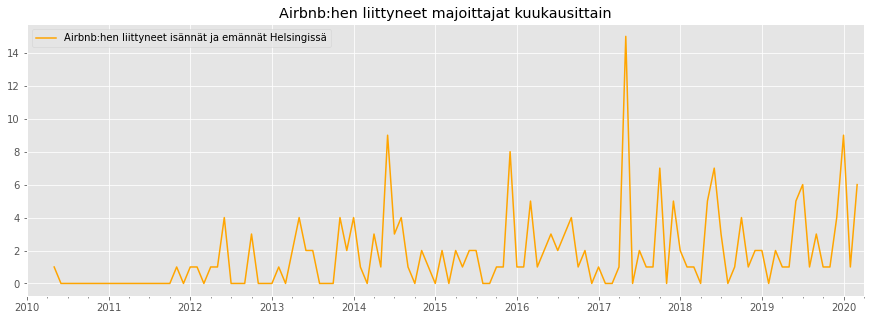

In [128]:
plt.figure(figsize=(15,5))
df_hosts_joined.set_index('member_since').resample('MS').size().plot(label='Airbnb:hen liittyneet isännät ja emännät Helsingissä', color='orange')
#df_hosts_joined.set_index('first_review').resample('MS').size().plot(label='Listings getting their first review', color='green')
plt.title('Airbnb:hen liittyneet majoittajat kuukausittain')
plt.legend()
plt.xlim('2010-01-01', '2020-04-20') # Limiting to whole months
plt.xlabel('')
plt.ylabel('')
plt.savefig('data/hy_joined_hosts_2020_04_20.png')
plt.show()

In [129]:
#member_since

NameError: name 'member_since' is not defined

In [130]:
#{min(df.member_since)}

In [131]:
df.isna().sum()

index                           0
accuracy_rating                44
allows_children                17
allows_events                  17
allows_infants                 17
allows_pets                    17
allows_smoking                 17
amenity_ids                     1
available_30                  220
avg_rating                     45
bathrooms                       0
bedroom_label                   0
bedrooms                        0
beds                            6
can_instant_book                0
cancel_policy                   0
checkin_rating                 44
city                            0
cleaning_fee                    0
cleanliness_rating             44
communication_rating           44
guest_overall_satisfaction    220
host_verified                   0
id                              0
is_business_travel_ready        0
is_new_listing                  0
is_super_host                   0
kicker_content_message          0
latest_review                 220
latitude      

In [99]:
api = airbnb.Api(randomize=True)

In [100]:
#Siirretty aikaisempaan kohtaan
"""for i in listing_ids:
    try:
        #time.sleep(3)
        if i == 28617132 or i == 42596142 or i == 41139203 or i == 2550059 or i == 34797998:
            add_response_rate(i, 0.0)
            continue
        time.sleep(2)
        print(i)
        if not has_response_rate_db(i):

            if has_response_rate(i):
                response_rate = get_response_rate(i)
                response_rate = response_rate[:-1]
                response_rate = float(response_rate)
                add_response_rate(i, response_rate)
            else:
                add_response_rate(i, 0.0)
    except requests.exceptions.RequestException:
        api = airbnb.Api(randomize=True)
        time.sleep(5)
        #response_rate = get_response_rate(i)
        add_response_rate(i, None)
        #if response_rate is None:
        #    continue
        #response_rate = response_rate[:-1]
        #response_rate = float(response_rate)
        #add_response_rate(i, response_rate)
    except:
        api = airbnb.Api(randomize=True)
        time.sleep(10)
        add_response_rate(i, None)
        #continue
        """

'for i in listing_ids:\n    try:\n        #time.sleep(3)\n        if i == 28617132 or i == 42596142 or i == 41139203 or i == 2550059 or i == 34797998:\n            add_response_rate(i, 0.0)\n            continue\n        time.sleep(2)\n        print(i)\n        if not has_response_rate_db(i):\n\n            if has_response_rate(i):\n                response_rate = get_response_rate(i)\n                response_rate = response_rate[:-1]\n                response_rate = float(response_rate)\n                add_response_rate(i, response_rate)\n            else:\n                add_response_rate(i, 0.0)\n    except requests.exceptions.RequestException:\n        api = airbnb.Api(randomize=True)\n        time.sleep(5)\n        #response_rate = get_response_rate(i)\n        add_response_rate(i, None)\n        #if response_rate is None:\n        #    continue\n        #response_rate = response_rate[:-1]\n        #response_rate = float(response_rate)\n        #add_response_rate(i, response_ra

## Adding response rates to database

In [132]:
def has_response_time_db(id):
    """
    Checks if a particular apartment (id) has response time data associated with it in the database
    """
    res = db.query("SELECT id, response_time FROM raw3 WHERE id={}".format(id))
    for row in res:
        id = row['id']
        response_time = row['response_time']
        
        if response_time is not None:
            return True
        return False

In [133]:
db = dataset.connect("sqlite:///data/helsinki-instant.db")

In [ ]:
#listing = get_listing(42993990)
#pdp = listing['pdp_listing_detail']
#primary_host = pdp['primary_host']
#primary_host
#response_time = primary_host['response_time_without_na']

In [ ]:
#pdp

In [ ]:
#pdp['primary_host']['member_since_full_str']

In [135]:
def has_response_time(id):
    """
    Checks, if response time data is defined/associated with the listing. I.e., is there a value for this or is it a null.
    """
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    
    if 'response_time_without_na' in primary_host.keys():
        return True
    return False

In [136]:
def get_response_time(id):
    """
    Gets the response time using the airbnb python package.
    """
    listing = get_listing(id)
    pdp = listing['pdp_listing_detail']
    primary_host = pdp['primary_host']
    response_time = primary_host['response_time_without_na']
    #print('response_rate: ', response_rate_without_na)
    return response_time

In [137]:
def add_response_time(id, response_time):
    """
    Adds the response time to the apartment in our database
    """
    res = db.query("SELECT id FROM raw3 WHERE id={}".format(id))
    table = db['raw3']
    for row in res:
        id = row['id']
        #response = row['response_rate']
        
        table.update(dict(id=id, response_time=response_time),['id'])

In [142]:
for i in listing_ids:
    #time.sleep(3)
    try:
        #if i == 28617132 or i == 42596142 or i == 41139203 or i == 2550059 or i == 34797998:
        #    add_response_time(i, 'unknown')
        #    continue
        time.sleep(3)
        print(i)
        # Checks whether the host has a response time already saved to database
        if not has_response_time_db(i):
            time.sleep(3)
            # Checks if there's a datapoint for this particular point
            if has_response_time(i):
                response_time = get_response_time(i)
                #response_rate = response_rate[:-1]
                #response_rate = float(response_rate)
                add_response_time(i, response_time)
            else:
                add_response_time(i, 'unknown')
    except:
        # Some times we run into errors. A host may've left the site, disabled his listings or something similar
        # which means, we can no longer fetch the data.
        add_response_time(i, 'unknown')

22858494
16501244
35440127
28982354
41969547
42901953
21557494
32799667
18230458
25500683
11468881
42403312
11540653
32034311
43049962
41476084
28617132
39774805
36353225
38771885
40033351
42684617
42596142
41758970
35047670
24045106
18521789
33890366
43064194
41478641
34085971
36196446
34367632
29644231
3408263
4459868
38727425
39487366
31606666
37905256
42545597
33603361
26240541
43030513
25399185
41781809
17834020
20977238
11879784
22055402
37514841
39853395
31213330
37307947
42935386
38743638
37231876
28050915
35713015
42985363
28234855
41869689
14752483
12675441
571881
42638153
31094469
2189594
35611309
38669174
18400611
39476359
42978180
35584843
35680811
22982896
33630332
42960124
12068779
41139203
30981155
20648483
14336951
18012739
35246331
36044616
39125871
21368320
21373833
41222077
43026916
27325365
11393587
40891430
34797998
18056441
32062249
16106110
22829257
41799984
41083834
26730354
40437632
36127077
17657846
37279768
22759628
21821456
31390306
21571373
40342883
225636

In [139]:
table_raw = db['raw3']

In [144]:
#print(item_db)

In [145]:
df2 = pd.read_sql_query('SELECT * FROM raw3',disk_engine)

In [144]:
df2

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",None,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsingfors,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.00,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",None,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.80,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
2,2,NaN,NaN,NaN,NaN,NaN,NaN,"[1, 2, 4, 8, 10, 77, 85, 21, 23, 89, 90, 91, 9...",None,4.80,1.0,1 bedroom,1.0,4.0,1,CANCEL_FLEXIBLE,NaN,Vantaa,0,NaN,NaN,None,0,35440127,0,0,1,Entire apartment,None,60.32108,https://www.airbnb.com/api/v2/pdp_listing_deta...,Vantaa,None,NaN,24.85522,1125,1,0.00,Stylish Apartment near Helsinki Vantaa Airport,None,None,None,6,13,"Wifi,Kitchen,Heating",None,$42,1.0,nightly,NaN,82.0,within an hour,NaN,NaN,91,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Cable TV, Hair dryer,...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,None,2017-09-01
3,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",None,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.00,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,90.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
4,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",None,NaN,4.0,1 bedroom,1.0,1.0,1,CANC

In [135]:
# We can fix the NA values later by binning
#df.accuracy_rating.fillna(0.0)

Lienee tulkinnanvaraista, miten kukin tulkitsee sitä, että lapsivieraita ei ole kielletty Airbnb-asunnosta erikseen. Itse näkisin, että todennäköisesti lapset ovat sallittuja, jollei niitä ole erikseen kielletty

In [184]:
df.allows_children.fillna(1.0)

0      1.0
1      1.0
2      1.0
3      1.0
4      1.0
      ... 
215    1.0
216    1.0
217    1.0
218    1.0
219    1.0
Name: allows_children, Length: 220, dtype: float64

In [185]:
df.allows_infants.fillna(1.0, inplace=True)

In [148]:
df.drop(['allows_smoking'], axis=1, inplace=True)

In [149]:
df.drop(['allows_events'], axis=1, inplace=True)

In [152]:
df.allows_infants.value_counts()

1.0    189
0.0     31
Name: allows_infants, dtype: int64

In [153]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,1.0,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",None,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,100.0,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,1.0,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",None,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,100.0,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
2,3,NaN,NaN,1.0,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",None,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,89.0,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
3,4,NaN,NaN,1.0,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",None,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kruununhaka,NaN,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,Kruununhaka,None,None,1,14,"Wifi,Heating",None,$24,45.0,nightly,NaN,100.0,None,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,None,Hostel beds,NaN,NaN,NaN,0.00,0,0,"Wifi, Air conditioning, Hair dryer, Iron, Sham...",1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2020-01-01
4,5,NaN,NaN,1.0,NaN,"[96, 1, 33, 2, 35, 4, 40, 104, 8, 41, 9, 45, 4...",None,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,None,0,42901953,0,1,0,Entire apartment,None,60.16563,https://www.airbnb.com/a

In [154]:
missing = df.isnull().sum()
missing[missing > 0].sort_values(ascending=False)

response_time                 220
latest_review                 220
host_id                       220
guest_overall_satisfaction    220
price_night                   220
self_checkin                  220
available_30                  220
neighborhood                   80
localized_neighborhood         80
avg_rating                     45
star_rating                    45
review_score                   44
checkin_rating                 44
cleanliness_rating             44
communication_rating           44
value_rating                   44
location_rating                44
accuracy_rating                44
allows_pets                    17
allows_children                17
p3_summary_address             17
p3_summary_title               17
requires_license               17
review_count                   17
visible_review_count           17
member_since                   14
beds                            6
amenities                       3
property_type_id                2
room_and_prope

## Tässä kohtaa availability_30 joudutaan poistamaan

Lähinnä siitä syystä, että en saa haettua enää tietoja tähän kenttään - luultavasti siitä syystä, että muutaman päivän ikäinen airbnb-raavinnan/-ryöminnän löytämien asuntojen omistajat jostakin syystä eivät salli tällä hetkellä itselleen vieraita tms. Jos ehdin implementoida ominaisuuden, joka hakee tietoja itsenäisesti aina tasaisin väliajoin, luultavasti em. available_30-tietoa koneoppimismallissani.

In [155]:
df.drop(['available_30', 'self_checkin', 'latest_review', 'price_night', 'neighborhood', 'localized_neighborhood', 'p3_summary_address', 'p3_summary_title' ], axis=1, inplace=True)

In [156]:
df.drop(['name'], axis=1, inplace=True)


In [160]:
df2.head()

,index,accuracy_rating,allows_children,allows_events,allows_infants,allows_pets,allows_smoking,amenity_ids,available_30,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latest_review,latitude,listing_url,localized_city,localized_neighborhood,location_rating,longitude,max_nights,min_nights,monthly_price_factor,name,neighborhood,p3_summary_address,p3_summary_title,person_capacity,picture_count,preview_amenities,price_night,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,self_checkin,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,amenities,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",None,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,None,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,Kamppi,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,Kamppi,None,None,2,17,"Wifi,Kitchen,Heating",None,$38,1.0,nightly,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,None,Entire apartment,4.5,NaN,NaN,0.90,0,0,"Elevator, Wifi, Kitchen, Hair dryer, Shampoo, ...",0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",None,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,None,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kamppi,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",Kamppi,None,None,7,22,"Wifi,Kitchen,Heating",None,$58,37.0,nightly,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,None,Entire condominium,5.0,NaN,NaN,0.88,8,217,"Wifi, Kitchen, Dryer, Hair dryer, Iron, Shampo...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
2,3,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",None,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,None,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Ullanlinna,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,Ullanlinna,None,None,3,3,"Wifi,Kitchen,Heating",None,$26,1.0,nightly,NaN,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,None,Shared room,5.0,NaN,NaN,0.00,0,0,"Elevator, Wifi, Kitchen, Dryer, Hair dryer, Sh...",0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
3,4,NaN,NaN,NaN,NaN,NaN,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",None,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,None,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,Kruununhaka,NaN,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,Kruununhaka,None,None,1,14,"Wifi,Heating",None,$24,45.0,nightly,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,None,Hostel beds,NaN,NaN,NaN,0.00,0,0,"Wifi, Air conditioning, Hair dryer, Iron, Sham...",1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2020-01-01
4,5,NaN,NaN,NaN,NaN,NaN,NaN,"[96, 1, 33, 2, 35, 4, 40, 104, 8, 41, 9, 45, 4...",None,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_F

In [161]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220 entries, 0 to 219
Data columns (total 85 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   index                       220 non-null    int64  
 1   accuracy_rating             176 non-null    float64
 2   allows_children             203 non-null    float64
 3   allows_events               203 non-null    float64
 4   allows_infants              203 non-null    float64
 5   allows_pets                 203 non-null    float64
 6   allows_smoking              203 non-null    float64
 7   amenity_ids                 219 non-null    object 
 8   available_30                0 non-null      object 
 9   avg_rating                  175 non-null    float64
 10  bathrooms                   220 non-null    float64
 11  bedroom_label               220 non-null    object 
 12  bedrooms                    220 non-null    float64
 13  beds                        214 non

In [163]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 220 entries, 0 to 219
Data columns (total 73 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   index                       220 non-null    int64  
 1   accuracy_rating             176 non-null    float64
 2   allows_children             203 non-null    float64
 3   allows_infants              220 non-null    float64
 4   allows_pets                 203 non-null    float64
 5   amenity_ids                 219 non-null    object 
 6   avg_rating                  175 non-null    float64
 7   bathrooms                   220 non-null    float64
 8   bedroom_label               220 non-null    object 
 9   bedrooms                    220 non-null    float64
 10  beds                        214 non-null    float64
 11  can_instant_book            220 non-null    int64  
 12  cancel_policy               220 non-null    object 
 13  checkin_rating              176 non

# Tätä copy-operaatioita ei olisi kannattanut tehdä. **(HUOM)**

Nyt jouduit tässä toisatmaan pari dropppia. Toisaalta tietokantaan oli saatu tietoja, jotka aiemmin puuttuivat.

In [165]:
df = df2.copy()

In [166]:
df.drop(['amenities'], axis=1, inplace=True)

### Host_id:n hakeminen alkoi yllättäen epäonnistua 

Onko Airbnb-asuntojen tarjonta niin vaihtelevaa, että välillä hakutuloksia saa ja välillä ei, riippuen siitä, onko kyseinen asunto ylipäänsä palvelussa aktiivisessa tilassa tms?

In [168]:
df.drop(['host_id'], axis=1, inplace=True)

In [ ]:
df.drop(['available_30', 'self_checkin', 'latest_review', 'price_night', 'neighborhood', 'localized_neighborhood', 'p3_summary_address', 'p3_summary_title' ], axis=1, inplace=True)

In [ ]:
df.drop(['name'], axis=1, inplace=True)

In [172]:
df.drop(['amenity_ids'],axis=1, inplace=True)

In [180]:
df.drop(['allows_events'], axis=1, inplace=True)
df.drop(['allows_smoking'], axis=1, inplace=True)
df.drop(["guest_overall_satisfaction"], axis=1, inplace=True)
df.drop(['preview_amenities'], axis=1, inplace=True)

In [181]:
df.drop(['rate_type'], axis=1, inplace=True)

In [186]:
df.head(50)

,index,accuracy_rating,allows_children,allows_infants,allows_pets,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,localized_city,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.93492,1125,1,0.00,2,17,$38,1.0,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.93362,60,1,0.80,7,22,$58,37.0,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.94423,6,1,0.00,3,3,$26,1.0,NaN,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.95787,1125,1,0.00,1,14,$24,45.0,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.92996,1125,1,0.90,4,13,$55,1.0,NaN,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01
5,6,NaN,NaN,1.0,NaN,4.91,1.0,1 bedroom,1.0,1.0,0,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,21557494,0,0,1,Private room,60.18126,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.95034,7,1,0.00,1,6,$49,1.0,NaN,100.0,within a few hours,NaN,NaN,162,Private room in apartment,Private room,private_room,Private room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,2017-10-01
6,7,NaN,NaN,1.0,NaN,4.84,1.0,Studio,0.0,2.0,1,CANCEL_MODERATE,NaN,Helsinki,27,NaN,NaN,0,32799667,0,0,1,Entire apartment,60.17029,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.94813,1125,1,0.00,4,21,$64,1.0,NaN,100.0,within an hour,NaN,NaN,138,Entire apartment,Entire home/apt,entire_home,Entire apartment,5.0,NaN,NaN,0.00,33,0,0.0,1.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,1.0,0.0,1.0,1.0,1.0,2018-09-01
7,8,NaN,NaN,1.0,NaN,4.87,1.5,Studio,0.0,2.0,1,CANCEL_MODERATE,NaN,Helsinki,16,

In [158]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,amenity_ids,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,guest_overall_satisfaction,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,localized_city,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,preview_amenities,price_string,property_type_id,rate_type,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,host_id,member_since
0,0,NaN,NaN,1.0,NaN,"[96, 4, 37, 40, 8, 41, 44, 45, 77, 47, 21, 85,...",4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.93492,1125,1,0.0,2,17,"Wifi,Kitchen,Heating",$38,1.0,nightly,NaN,100.0,None,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,None,2018-01-01
1,1,NaN,NaN,1.0,NaN,"[64, 129, 1, 4, 8, 10, 77, 85, 89, 90, 91, 92,...",4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,None,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.93362,60,1,0.8,7,22,"Wifi,Kitchen,Heating",$58,37.0,nightly,NaN,100.0,None,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,None,2013-07-01
2,3,NaN,NaN,1.0,NaN,"[96, 1, 33, 34, 131, 35, 4, 36, 37, 40, 8, 41,...",4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,None,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.94423,6,1,0.0,3,3,"Wifi,Kitchen,Heating",$26,1.0,nightly,NaN,89.0,None,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,None,2018-10-01
3,4,NaN,NaN,1.0,NaN,"[64, 66, 4, 132, 5, 73, 77, 85, 89, 90, 93, 30...",NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,None,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsinki,NaN,24.95787,1125,1,0.0,1,14,"Wifi,Heating",$24,45.0,nightly,NaN,100.0,None,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2020-01-01
4,5,NaN,NaN,1.0,NaN,"[96, 1, 33, 2, 35, 4, 40, 104, 8, 41, 9, 45, 4...",NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,None,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,Helsingfors,NaN,24.92996,1125,1,0.9,4,13,"Wifi,Kitchen,Free parking,Heating",$55,1.0,nightly,NaN,100.0,None,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,None,2018-05-01


In [187]:
df.localized_city.value_counts

<bound method IndexOpsMixin.value_counts of 0      Helsingfors
1         Helsinki
2         Helsinki
3         Helsinki
4      Helsingfors
          ...     
215    Helsingfors
216       Helsinki
217       Helsinki
218       Helsinki
219       Helsinki
Name: localized_city, Length: 220, dtype: object>

In [188]:
df.drop(['localized_city'], axis=1, inplace=True)

In [189]:
nyt = datetime.now().date()
nytstr = str(nyt)

In [190]:
lopettaessa_timestamp =df.to_csv(r"data/hy-lopettaessa"+nytstr+".csv", index=id, header=True)

In [191]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93492,1125,1,0.0,2,17,$38,1.0,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93362,60,1,0.8,7,22,$58,37.0,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.94423,6,1,0.0,3,3,$26,1.0,NaN,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.95787,1125,1,0.0,1,14,$24,45.0,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.92996,1125,1,0.9,4,13,$55,1.0,NaN,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


In [192]:
lopettaessa = df.to_csv(r'data/hel/hy-lopettaessa.csv', index=id, header=True)

In [193]:
#df = pd.read_csv(r'data/hy-lopettaessa.csv', low_memory=False)
#df = pd.read_csv('data/hy-lopettaessa.csv', index_col=0, low_memory=False)
df = pd.read_csv('data/hel/hy-lopettaessa.csv', index_col=0, low_memory=False)
pd.set_option('display.max_columns', len(df.columns)) # To view all columns
pd.set_option('display.max_rows', 100)

In [194]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93492,1125,1,0.0,2,17,$38,1.0,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93362,60,1,0.8,7,22,$58,37.0,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.94423,6,1,0.0,3,3,$26,1.0,NaN,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.95787,1125,1,0.0,1,14,$24,45.0,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.92996,1125,1,0.9,4,13,$55,1.0,NaN,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


In [195]:
df.room_type.value_counts()

Entire home/apt    140
Private room        73
Shared room          6
Hotel room           1
Name: room_type, dtype: int64

## Hinnan korjaus

In [196]:
df.price_string = df.price_string.str[1:]
df.price_string = df.price_string.astype('int64')

In [197]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,avg_rating,bathrooms,bedroom_label,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,requires_license,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,Studio,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93492,1125,1,0.0,2,17,38,1.0,NaN,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1 bedroom,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93362,60,1,0.8,7,22,58,37.0,NaN,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1 bedroom,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.94423,6,1,0.0,3,3,26,1.0,NaN,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1 bedroom,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.95787,1125,1,0.0,1,14,24,45.0,NaN,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1 bedroom,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.92996,1125,1,0.9,4,13,55,1.0,NaN,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


# Fixing beds, bathrooms, and bedrooms with medians

Replacing missing values with median but the purpose is also to avoid fractions

In [198]:
for col in ['bathrooms', 'bedrooms', 'beds']:
    df[col].fillna(df[col].median(), inplace=True)

## Removing bedroom_label

this seems like a row, which doesn't really give us much more information. It might be safe to remove it.

In [199]:
df.drop(['bedroom_label'], axis=1, inplace=True)

In [173]:
#df.drop(['amenity_ids'], axis=1, inplace=True)

## rate_type

All our dataset entries seem to be of the same rate_type. This column can, therefore, be dropped.

In [174]:
df.rate_type.value_counts()

nightly    220
Name: rate_type, dtype: int64

In [175]:
df.drop(['rate_type'], axis=1, inplace=True)

## requires_license

In [200]:
df.requires_license.value_counts()

0.0    203
Name: requires_license, dtype: int64

Kaikki tietomme tässä kentässä näyttävät olevan arvoltaan False. Ts. Airbnb-isännät/emännät eivät todennäköisesti ole viitsineet täyttää requires_license-kenttää, jolloin he tuskin myöskään edellyttävät henkilötodistuksen esittämistä asuntoa vuokrattaessa.

In [201]:
df.drop(['requires_license'], axis=1, inplace=True)

## Varmistetaan, että cleaning_fee, extra_people, ja security (joka tarkoittaa security_deposit) ovat samaa tietotyyppiä kuin price_string eli  (int64)

In [202]:
df.extra_people = df.extra_people.astype('int64')
df.security = df.security.astype('int64')
df.cleaning_fee = df.cleaning_fee.astype('int64')

# Tallennus ennen arvostelusarakkeiden uudelleen nimeämistä

In [203]:
#before_column_rename_df = df.to_csv(r'data/hy-before_column_rename.csv', index=id, header=True)
before_column_rename_df = df.to_csv(r'data/hel/hy-before_column_rename.csv', index=id, header=True)
aika = str(datetime.now())
varakappeleen_nimi = "hy-before_column_rename"+aika+".csv"
#before_column_rename_df = df.to_csv(r'data/hel/hy-before_column_rename)
df.to_csv(r"data/hel/"+varakappeleen_nimi, index=id, header=True)

In [204]:
df = pd.read_csv('data/hel/hy-before_column_rename.csv', index_col=0)

In [205]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 220 entries, 0 to 219
Data columns (total 65 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   index                     220 non-null    int64  
 1   accuracy_rating           176 non-null    float64
 2   allows_children           203 non-null    float64
 3   allows_infants            220 non-null    float64
 4   allows_pets               203 non-null    float64
 5   avg_rating                175 non-null    float64
 6   bathrooms                 220 non-null    float64
 7   bedrooms                  220 non-null    float64
 8   beds                      220 non-null    float64
 9   can_instant_book          220 non-null    int64  
 10  cancel_policy             220 non-null    object 
 11  checkin_rating            176 non-null    float64
 12  city                      220 non-null    object 
 13  cleaning_fee              220 non-null    int64  
 14  cleanlines

In [206]:
pd.set_option('display.max_columns', len(df.columns)) # To view all columns
pd.set_option('display.max_rows', 250)

In [207]:
df.head()

,index,accuracy_rating,allows_children,allows_infants,allows_pets,avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,checkin_rating,city,cleaning_fee,cleanliness_rating,communication_rating,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,location_rating,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,review_score,reviews_count,room_and_property_type,room_type,room_type_category,space_type,star_rating,value_rating,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93492,1125,1,0.0,2,17,38,1.0,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93362,60,1,0.8,7,22,58,37.0,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.94423,6,1,0.0,3,3,26,1.0,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.95787,1125,1,0.0,1,14,24,45.0,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.92996,1125,1,0.9,4,13,55,1.0,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


In [209]:
## Tekemällä oppii, mm. sen, että pandasilla voi ottaa kaikki tietyllä merkkijonolla alkavat
## sarakkeet kerralla käsittelyyn. Tällöin on mielekkäämpää nimetä sarakkeet yhtenevämmin, sillä
## niitä voidaan käsitellä ikään kuin bulkkihengessä.

In [208]:
df.rename(columns={'value_rating': 'reviews_scores_value',
                  'star_rating': 'reviews_scores_star',
                  'review_score': 'reviews_scores_rating',
                  'communication_rating': 'reviews_scores_communication',
                  'cleanliness_rating': 'reviews_scores_cleanliness',
                  'checkin_rating': 'reviews_scores_checkin',
                  'avg_rating': 'reviews_scores_avg_rating',
                  'location_rating': 'reviews_scores_location',
                  'accuracy_rating': 'reviews_scores_accuracy'}, inplace=True)

# Room types

Since there's only 1 entry of room_type *hotel_room*, it might be a good idea to combine this with some other category. The most suitable - to me, at least - seems like private room, since hotel rooms are more like rooms than entire apartments - they usually lack cooking facilities, for example

### room_type_category

In [210]:
df.room_type_category.value_counts()

entire_home     140
private_room     73
shared_room       6
hotel_room        1
Name: room_type_category, dtype: int64

In [211]:
df.room_type_category.replace({
    'hotel_room': 'private_room',
    }, inplace=True)

In [212]:
df.room_type_category.value_counts()

entire_home     140
private_room     74
shared_room       6
Name: room_type_category, dtype: int64

### room_type

In [213]:
df.room_type.value_counts()

Entire home/apt    140
Private room        73
Shared room          6
Hotel room           1
Name: room_type, dtype: int64

In [214]:
df.room_type.replace({
    'Hotel room': 'Private room',
    }, inplace=True)


In [215]:
df.room_type.value_counts()

Entire home/apt    140
Private room        74
Shared room          6
Name: room_type, dtype: int64

In [216]:
df.head()

,index,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,NaN,NaN,1.0,NaN,4.67,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93492,1125,1,0.0,2,17,38,1.0,100.0,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,4.5,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,NaN,NaN,1.0,NaN,4.81,1.5,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.93362,60,1,0.8,7,22,58,37.0,100.0,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,NaN,NaN,1.0,NaN,4.79,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.94423,6,1,0.0,3,3,26,1.0,89.0,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,NaN,NaN,1.0,NaN,NaN,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.95787,1125,1,0.0,1,14,24,45.0,100.0,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,NaN,NaN,1.0,NaN,NaN,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,NaN,24.92996,1125,1,0.9,4,13,55,1.0,100.0,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


## Tallennus **(huom)**

In [227]:
df.to_csv(r"data/hel/before_binnings_hel.csv", index=id, header=True)

# Binning

In [219]:
def bin_column(col, bins, labels, na_label='unknown'):
    """
    Takes in a column name, bin cut points and labels, replaces the original column with a
    binned version, and replaces nulls (with 'unknown' if unspecified).
    """
    df[col] = pd.cut(df[col], bins=bins, labels=labels, include_lowest=True)
    df[col] = df[col].astype('str')
    df[col].fillna(na_label, inplace=True)

In [220]:
%matplotlib inline

## Arvostelukategorioissa arvostelupisteiden jakautuminen asuntojen kesken **(huom)**

 * review_scores_rating - vieraiden asunnolle antama yleisarvosana 1-5
 * review_scores_accuracy - guests can score the accuracy of a property's description from 1 to 5 stars
 * review_scores_cleanliness - guests can score a property's cleanliness from 1 to 5 stars
 * review_scores_checkin - guests can score their check-in from 1 to 5 stars
 * review_scores_communication - guests can score a host's communication from 1 to 5 stars
 * review_scores_location - guests can score a property's location from 1 to 5 stars
 * review_scores_value - guests can score a booking's value for money from 1 to 5 stars
 * review_scores_avg_rating - keskimääräinen arvosana arvostelukategorioissa

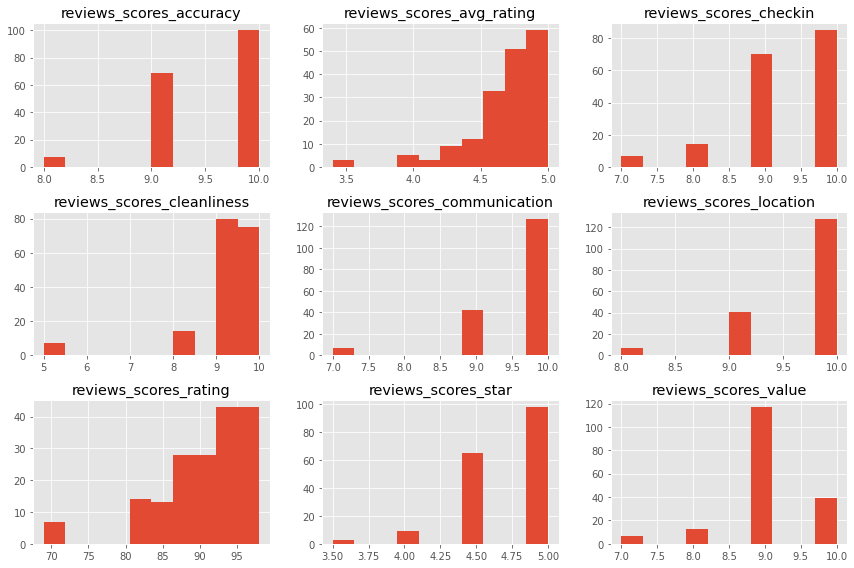

In [221]:
# Checking the distributions of the review ratings columns
variables_to_plot = list(df.columns[df.columns.str.startswith("reviews_scores") == True])
fig = plt.figure(figsize=(12,8))
for i, var_name in enumerate(variables_to_plot):
    ax = fig.add_subplot(3,3,i+1)
    df[var_name].hist(bins=10,ax=ax)
    ax.set_title(var_name)
fig.tight_layout()
plt.show()

In [154]:
#df['reviews_scores_cleanliness']

In [155]:
#bin_column('reviews_scores_rating',
#           bins=[0, 80, 95, 100],
#           labels=['0-79/100', '80-94/100', '95-100/100'],
#           na_label='no reviews')

In [ ]:
# Binning the only rating scored 0-100, reviews_scores_rating
bin_column('reviews_scores_rating',
          bins=[0, 80, 95, 100],
          labels=['0-79/100', '80-94/100', '95-100/100'],
          na_label='no reviews')

In [223]:
df.reviews_scores_star.value_counts()

5.0    98
4.5    65
4.0     9
3.5     3
Name: reviews_scores_star, dtype: int64

In [224]:
bin_column('reviews_scores_star',
          bins=[0, 3.6, 4.5, 5.0],
          labels=['0-3.5/5.0', '3.6-4.4/5.0', '4.5-5.0/5.0'],
          na_label='no_reviews')

In [225]:
bin_column('reviews_scores_avg_rating',
          bins=[0, 3.6, 4.5, 5.0],
          labels=['0-3.5/5.0', '3.6-4.4/5.0', '4.5-5.0/5.0'],
          na_label='no_reviews')

In [229]:
# To bin all the ratings columns with values 0-10 at once, let's pop reviews_scores_star, reviews_scores_avg_rating,
# and reviews_scores_rating from our variables_to_plot-list.

# Popping the second item in the list, reviews_scores_avg_rating
variables_to_plot.pop(1)

# If you don't give the pop method an index, it'll pop the last member of the list. We want to pop the last 2
# so we'll do this twice.
variables_to_plot.pop()
variables_to_plot.pop()

'reviews_scores_star'

In [230]:
variables_to_plot

['reviews_scores_accuracy',
 'reviews_scores_checkin',
 'reviews_scores_cleanliness',
 'reviews_scores_communication',
 'reviews_scores_location',
 'reviews_scores_rating']

In [ ]:
# Actual binning of the ones left in the list
"""for col in variables_to_plot:
    bin_column(col,
               bins=[0, 8, 9, 10],
               labels=['0-8/10', '9/10', '10/10'],
               na_label='no_reviews')"""

In [232]:
bin_column('reviews_scores_value',
           bins=[0, 8, 9, 10],
           labels=['0-8/10', '9/10', '10/10'],
           na_label='no_reviews')

In [204]:
#df['reviews_scores_value']

## Binning host_response_rate

In [233]:
df.head()

,index,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,nan,NaN,1.0,NaN,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93492,1125,1,0.0,2,17,38,1.0,100.0,within an hour,NaN,nan,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,nan,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,nan,NaN,1.0,NaN,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,nan,Helsinki,0,nan,nan,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93362,60,1,0.8,7,22,58,37.0,100.0,within an hour,NaN,nan,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,nan,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,nan,NaN,1.0,NaN,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.94423,6,1,0.0,3,3,26,1.0,89.0,within an hour,NaN,nan,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,nan,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,nan,NaN,1.0,NaN,nan,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,nan,Helsinki,0,nan,nan,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.95787,1125,1,0.0,1,14,24,45.0,100.0,within an hour,NaN,nan,2,Shared room in hostel,Shared room,shared_room,Hostel beds,nan,nan,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,nan,NaN,1.0,NaN,nan,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,nan,Helsinki,11,nan,nan,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.92996,1125,1,0.9,4,13,55,1.0,100.0,within a few hours,NaN,nan,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,nan,nan,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


In [207]:
#bin_column('reponse_rate',
#          bins=[])
#df['response_rate'] = df2['response_rate']

## Kuinka suuri Airbnb-isäntien/emäntien response_rate on aineistossa?

Eli toisin sanoen tutkitaan, kuinka monelle vierasehdokkaalle isännät/emännät jättävät vastaamatta syystä tai toisesta.

In [243]:
print("Keskimääräinen vastausaste ('response_rate') asiakkaille on: ", round(df['response_rate'].mean(), 0))
print("Vastausasteen mediaani:", df['response_rate'].median())
print(f"100% kyselyistä/tiedusteluista vastaavien isäntien ja emäntien osuus: {round(((df.response_rate == 100.0).sum()/df.response_rate.count())*100,1)}%")

Keskimääräinen vastausaste ('response_rate') asiakkaille on:  83.0
Vastausasteen mediaani: 100.0
100% kyselyistä/tiedusteluista vastaavien isäntien ja emäntien osuus: 68.2%


In [240]:
df.response_rate.value_counts

<bound method IndexOpsMixin.value_counts of 0      100.0
1      100.0
2       89.0
3      100.0
4      100.0
5      100.0
6      100.0
7      100.0
8       90.0
9       80.0
10     100.0
11     100.0
12     100.0
13     100.0
14       0.0
15     100.0
16     100.0
17       0.0
18       0.0
19       0.0
20      80.0
21      71.0
22      91.0
23     100.0
24       0.0
25      71.0
26     100.0
27     100.0
28     100.0
29     100.0
30     100.0
31     100.0
32     100.0
33      80.0
34       0.0
35      90.0
36     100.0
37     100.0
38      73.0
39     100.0
40     100.0
41     100.0
42     100.0
43     100.0
44     100.0
45     100.0
46     100.0
47     100.0
48     100.0
49     100.0
50     100.0
51      71.0
52     100.0
53     100.0
54     100.0
55     100.0
56       0.0
57      71.0
58     100.0
59     100.0
60      78.0
61       0.0
62     100.0
63     100.0
64     100.0
65       0.0
66     100.0
67       0.0
68      73.0
69     100.0
70      73.0
71     100.0
72     100.0
73     

In [241]:
print("Null values:", df.response_rate.isna().sum())
print(f"Proportion: {round((df.response_rate.isna().sum()/len(df))*100, 1)}%")

Null values: 0
Proportion: 0.0%


In [211]:
df.isna().sum()

index                             0
reviews_scores_accuracy           0
allows_children                  17
allows_infants                   17
allows_pets                      17
available_30                    220
reviews_scores_avg_rating         0
bathrooms                         0
bedrooms                          0
beds                              0
can_instant_book                  0
cancel_policy                     0
reviews_scores_checkin            0
city                              0
cleaning_fee                      0
reviews_scores_cleanliness        0
reviews_scores_communication      0
guest_overall_satisfaction      220
host_verified                     0
id                                0
is_business_travel_ready          0
is_new_listing                    0
is_super_host                     0
kicker_content_message            0
latest_review                   220
latitude                          0
listing_url                       0
localized_city              

In [242]:
#print("Mean host response rate:", round(df['response_rate'].mean(),0))
#print("Median host response rate:", df['response_rate'].median())
#print(f"Proportion of 100% host response rates: {round(((df.response_rate == 100.0).sum()/df.response_rate.count())*100,1)}%")

Mean host response rate: 83.0
Median host response rate: 100.0
Proportion of 100% host response rates: 68.2%


In [213]:
#df['response_rate'].isna().sum()

0

In [244]:
df.desponse_rate = df.response_rate.astype('float64')

### response_raten binnaus

In [245]:
# Binning into 4 categories
df.response_rate = pd.cut(df.response_rate, bins=[0, 50, 90, 99, 100], labels=['0-49%', '50-89%', '90-99%', '100%'], include_lowest=True)

# converting to string
df.reponse_rate = df.response_rate.astype('str')

# replace nulls with unknown
df.response_rate.replace('nan', 'unknown', inplace=True)

# entires in each bin/category
df.response_rate.value_counts()

100%      150
50-89%     40
0-49%      29
90-99%      1
Name: response_rate, dtype: int64

In [246]:
#df['response_rate'].fillna('unknown')

In [247]:
df.response_rate.value_counts()

100%      150
50-89%     40
0-49%      29
90-99%      1
Name: response_rate, dtype: int64

In [249]:
df.response_time.value_counts

<bound method IndexOpsMixin.value_counts of 0          within an hour
1          within an hour
2          within an hour
3          within an hour
4      within a few hours
5      within a few hours
6          within an hour
7      within a few hours
8      within a few hours
9          within an hour
10         within an hour
11     within a few hours
12                unknown
13                unknown
14                unknown
15                unknown
16         within an hour
17                unknown
18                unknown
19                unknown
20         within an hour
21                unknown
22                unknown
23                unknown
24                unknown
25         within an hour
26         within an hour
27         within an hour
28     within a few hours
29         within an hour
30         within an hour
31         within an hour
32         within an hour
33         within an hour
34                unknown
35         within an hour
36         within an

In [220]:
#df['response_time'] = df2['response_time']

In [251]:
#df['response_time'].value_counts

In [252]:
df.head()

,index,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,nan,NaN,1.0,NaN,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93492,1125,1,0.0,2,17,38,1.0,100%,within an hour,NaN,nan,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,nan,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,nan,NaN,1.0,NaN,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,nan,Helsinki,0,nan,nan,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93362,60,1,0.8,7,22,58,37.0,100%,within an hour,NaN,nan,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,nan,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,nan,NaN,1.0,NaN,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.94423,6,1,0.0,3,3,26,1.0,50-89%,within an hour,NaN,nan,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,nan,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,nan,NaN,1.0,NaN,nan,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,nan,Helsinki,0,nan,nan,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.95787,1125,1,0.0,1,14,24,45.0,100%,within an hour,NaN,nan,2,Shared room in hostel,Shared room,shared_room,Hostel beds,nan,nan,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,nan,NaN,1.0,NaN,nan,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,nan,Helsinki,11,nan,nan,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.92996,1125,1,0.9,4,13,55,1.0,100%,within a few hours,NaN,nan,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,nan,nan,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


### Toisaalta asiakkaat pyrkivät varmasti myös säästämään vaivaa – nopeat syövät hitaat?

In [253]:
df.response_time.value_counts(normalize=True)

within an hour        0.650000
within a few hours    0.145455
unknown               0.145455
within a day          0.045455
a few days or more    0.013636
Name: response_time, dtype: float64

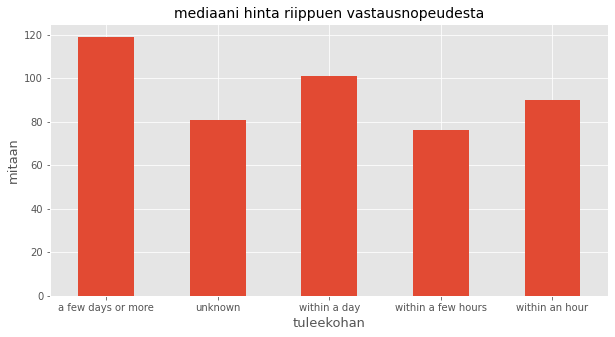

In [260]:
plt.figure(figsize=(10,5))
df.groupby('response_time').price_string.median().plot(kind='bar')
plt.title('mediaani hinta riippuen vastausnopeudesta', fontsize=14)
plt.xlabel('tuleekohan', fontsize=13)
plt.ylabel('mitaan', fontsize=13)
plt.xticks(rotation=0)
#plt.xlim(left=0.5)
plt.show()

Optimisti voisi kai päätellä, että asiakkaat täytyy pitää odottamassa, sillä pari päivää tai pidempään asiakkaitaan odotuttavat näyttävät saavan korkeimman hinnan. Todellisuudessat tällaisia isäntiä on kuitenkin vähemmistä aineistosta, kuten jo edellä näkyvästä value_counts-tuloksista näkyy.  

Nämä pitkään asiakkaitaan odotuttavat asunnot ovat luultavasti huomattavasti normaalista poikkeavia, joita ihmiset ovat valmiita hetken odottamaankin. Toisaalta kun käytettävissä ei ole niitä hintoja, joilla asunto on saatu vuokrattua, voi tilasto selittyä silläkin, että nämä isännät/emännät pyytävät korkeampaa hintaa kuin muut jostain muusta syystä. He saattavat olla kokeneempia hinnoittelijoita tai vuokraavat omaa asuntoaan eivätkä ole halukkaita vuokraamaan sitä muille, jollei hinta ole riittävän korkea.

In [254]:
df.head()
df.allows_children.fillna(1.0, inplace=True)

In [255]:
df.allows_infants.fillna(1.0, inplace=True)

In [256]:
df.allows_pets.fillna(0.0, inplace=True)

### Hinta plottaukset alkoivat tallennus

In [228]:
df.to_csv(r'data/hy_kohta_jossa_alkoi_hinta_plottaukset.csv', index=id, header=True)

In [266]:
%matplotlib inline
#sns.set()

# Prices

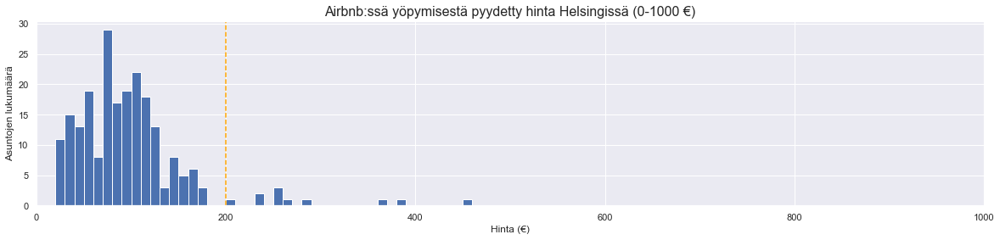

In [269]:

# Hintajakauma välillä 0-1000 €
plt.figure(figsize=(20,4))
df.price_string.hist(bins=100, range=(0,1000))
plt.margins(x=0)
plt.axvline(200, color='orange', linestyle='--')
plt.title("Airbnb:ssä yöpymisestä pyydetty hinta Helsingissä (0-1000 €)", fontsize=16)
plt.xlabel("Hinta (€)")
plt.ylabel("Asuntojen lukumäärä")
plt.savefig('data/hel/prices_hel_nightly_0-1000e.png')
plt.show()

Kuvaan jää selkeästi turhan paljon tyhjää oikealle. Riittänee tarkastella asuntoja, joissa yöpyminen maksaa 0-600 euroa.

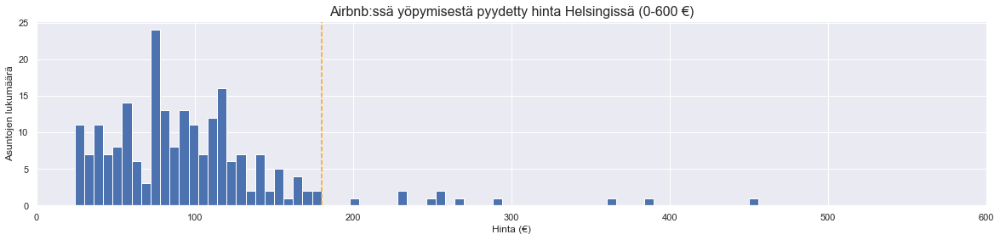

In [271]:

# Hintajakauma välillä 0-1000 €
plt.figure(figsize=(20,4))
df.price_string.hist(bins=100, range=(0,600))
plt.margins(x=0)
plt.axvline(180, color='orange', linestyle='--')
plt.title("Airbnb:ssä yöpymisestä pyydetty hinta Helsingissä (0-600 €)", fontsize=16)
plt.xlabel("Hinta (€)")
plt.ylabel("Asuntojen lukumäärä")
plt.savefig('data/hel/prices_hel_nightly_0-600e.png')
plt.show()

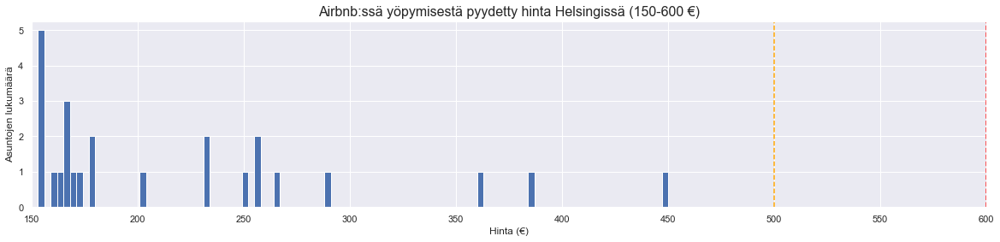

In [273]:
#Hinta jakauma 150 ylöspäin
plt.figure(figsize=(20,4))
df.price_string.hist(bins=100, range=(150, max(df.price_string)))
plt.margins(x=0)
plt.axvline(500, color='orange', linestyle='--')
plt.axvline(600, color='red', linestyle='--')
plt.title("Airbnb:ssä yöpymisestä pyydetty hinta Helsingissä (150-600 €)", fontsize=16)
plt.xlabel("Hinta (€)")
plt.ylabel("Asuntojen lukumäärä")
plt.show()

In [275]:
# Korvataan hinnat, jotka ovat alle 10, 10:llä
df.loc[df.price_string <= 10, 'price_string'] = 10

# Korvataan hinnat, jotka ovat yli 1000 € 1000 €:lla - näitä ei vielä ole, mutta oletetaan, että niitä voisi tulla
df.loc[df.price_string >= 1000, 'price_string'] = 1000

In [276]:
df.head()

,index,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,id,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,listing_url,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,member_since
0,0,nan,1.0,1.0,0.0,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,22858494,0,0,0,Entire apartment,60.16708,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93492,1125,1,0.0,2,17,38,1.0,100%,within an hour,NaN,nan,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,nan,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,2018-01-01
1,1,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,nan,Helsinki,0,nan,nan,0,16501244,0,0,1,Entire condominium,60.16653,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.93362,60,1,0.8,7,22,58,37.0,100%,within an hour,NaN,nan,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,nan,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,2013-07-01
2,3,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,28982354,0,0,1,Shared room,60.15867,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.94423,6,1,0.0,3,3,26,1.0,50-89%,within an hour,NaN,nan,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,nan,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,2018-10-01
3,4,nan,1.0,1.0,0.0,nan,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,nan,Helsinki,0,nan,nan,0,41969547,0,1,0,Hostel beds,60.17884,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.95787,1125,1,0.0,1,14,24,45.0,100%,within an hour,NaN,nan,2,Shared room in hostel,Shared room,shared_room,Hostel beds,nan,nan,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,2020-01-01
4,5,nan,1.0,1.0,0.0,nan,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,nan,Helsinki,11,nan,nan,0,42901953,0,1,0,Entire apartment,60.16563,https://www.airbnb.com/api/v2/pdp_listing_deta...,nan,24.92996,1125,1,0.9,4,13,55,1.0,100%,within a few hours,NaN,nan,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,nan,nan,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,2018-05-01


In [277]:
plt.style.use('default')
import seaborn as sns
sns.set()

## Median price of Airbnbs accomodating different numbers of guests

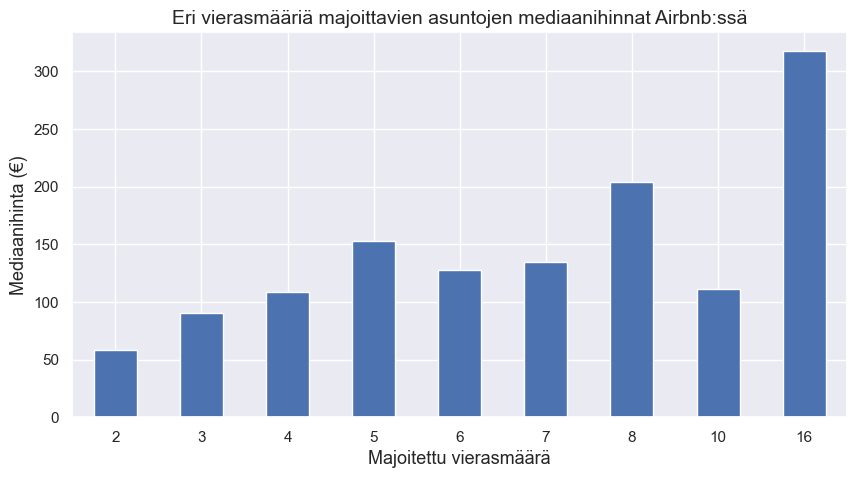

In [278]:
plt.figure(figsize=(10,5))
df.groupby('person_capacity').price_string.median().plot(kind='bar')
plt.title('Eri vierasmääriä majoittavien asuntojen mediaanihinnat Airbnb:ssä', fontsize=14)
plt.xlabel('Majoitettu vierasmäärä', fontsize=13)
plt.ylabel('Mediaanihinta (€)', fontsize=13)
plt.xticks(rotation=0)
plt.xlim(left=0.5)
plt.savefig('data/hel/Median_price_of_Airbnbs_accommodating_different_number_of_guests-helsinki.png')
plt.show()

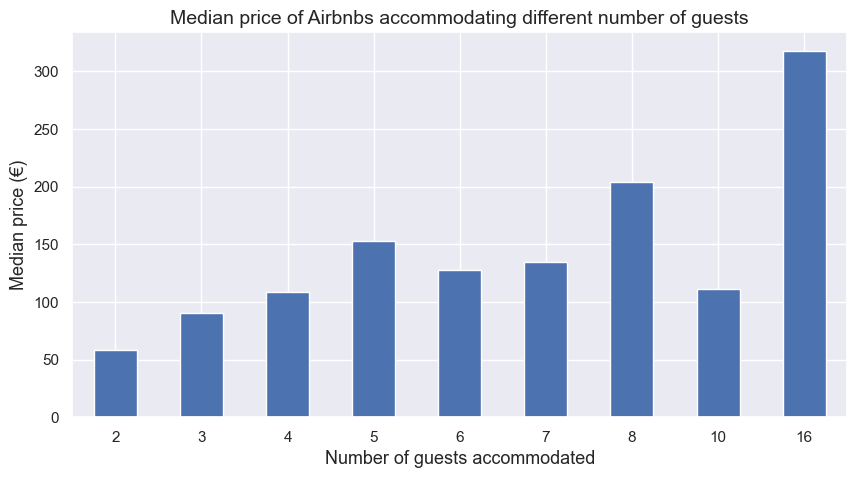

In [184]:

plt.figure(figsize=(10,5))
df.groupby('person_capacity').price_string.median().plot(kind='bar')
plt.title('Median price of Airbnbs accommodating different number of guests', fontsize=14)
plt.xlabel('Number of guests accommodated', fontsize=13)
plt.ylabel('Median price (€)', fontsize=13)
plt.xticks(rotation=0)
plt.xlim(left=0.5)
plt.show()

In [185]:
# Or listed here more carefully:
print(df.groupby('person_capacity').price_string.median())

person_capacity
1      59.0
2      58.0
3      90.0
4     109.0
5     153.0
6     128.0
7     135.0
8     204.0
10    111.5
16    318.0
Name: price_string, dtype: float64


In [186]:
df.person_capacity.value_counts()

2     80
4     53
3     43
6     11
8     10
1      9
5      7
7      3
16     2
10     2
Name: person_capacity, dtype: int64

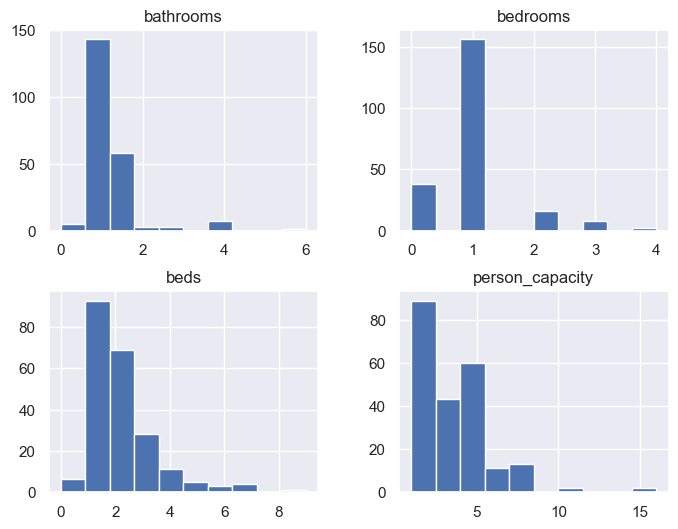

In [187]:
df[['person_capacity', 'bathrooms', 'bedrooms', 'beds']].hist(figsize=(8,6));

# Categorical features

## Neighbourhood / kaupunginosa

In [188]:
# Renaming the neighbourhood column
#df.rename(columns={'neighbourhood_cleansed': 'borough'}, inplace=True)

# Importing the London borough boundary GeoJSON file as a dataframe in geopandas
#map_df = gpd.read_file('data/neighbourhoods.geojson')
#map_df.head()

In [189]:
df.head()

,id,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,localized_city,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,name,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,paikkakunnat
0,22858494,nan,1.0,1.0,0.0,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,0,0,0,Entire apartment,60.16708,Helsingfors,nan,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,2,17,38,1.0,100%,within an hour,NaN,nan,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Kamppi
1,16501244,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,nan,Helsinki,0,nan,nan,0,0,0,1,Entire condominium,60.16653,Helsinki,nan,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",7,22,58,37.0,100%,within an hour,NaN,nan,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,Kamppi
2,28982354,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,0,0,1,Shared room,60.15867,Helsinki,nan,24.94423,6,1,0.0,Shared apartment near the city center and the sea,3,3,26,1.0,50-89%,within an hour,NaN,nan,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,Siltasaari
3,41969547,nan,1.0,1.0,0.0,nan,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,nan,Helsinki,0,nan,nan,0,0,1,0,Hostel beds,60.17884,Helsinki,nan,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,1,14,24,45.0,100%,within an hour,NaN,nan,2,Shared room in hostel,Shared room,shared_room,Hostel beds,nan,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,Kamppi
4,42901953,nan,1.0,1.0,0.0,nan,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,nan,Helsinki,11,nan,nan,0,0,1,0,Entire apartment,60.16563,Helsingfors,nan,24.92996,1125,1,0.9,Beautiful apartment in the Centre Helsinki.,4,13,55,1.0,100%,within a few hours,NaN,nan,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,nan,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,Linjat


In [214]:
df['NIMI'] = df['paikkakunnat']

In [215]:
df.head()

,id,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,localized_city,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,name,person_capacity,picture_count,price_string,...,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,paikkakunnat,NIMI
0,22858494,nan,1.0,1.0,0.0,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,0,0,0,Entire apartment,60.16708,Helsingfors,nan,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,2,17,38,...,within an hour,NaN,nan,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Kamppi,Kamppi
1,16501244,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,nan,Helsinki,0,nan,nan,0,0,0,1,Entire condominium,60.16653,Helsinki,nan,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",7,22,58,...,within an hour,NaN,nan,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,Kamppi,Kamppi
2,28982354,nan,1.0,1.0,0.0,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,nan,Helsinki,0,nan,nan,0,0,0,1,Shared room,60.15867,Helsinki,nan,24.94423,6,1,0.0,Shared apartment near the city center and the sea,3,3,26,...,within an hour,NaN,nan,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,Siltasaari,Siltasaari
3,41969547,nan,1.0,1.0,0.0,nan,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,nan,Helsinki,0,nan,nan,0,0,1,0,Hostel beds,60.17884,Helsinki,nan,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,1,14,24,...,within an hour,NaN,nan,2,Shared room in hostel,Shared room,shared_room,Hostel beds,nan,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,Kamppi,Kamppi
4,42901953,nan,1.0,1.0,0.0,nan,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,nan,Helsinki,11,nan,nan,0,0,1,0,Entire apartment,60.16563,Helsingfors,nan,24.92996,1125,1,0.9,Beautiful apartment in the Centre Helsinki.,4,13,55,...,within a few hours,NaN,nan,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,nan,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,Linjat,Linjat


In [216]:
# Importing the Edinburgh borough boundary GeoJSON file as a dataframe in geopandas
map_df = gpd.read_file(r'data/osaalueet.geojson')
map_df.head()

,Name,descriptio,timestamp,begin,end,altitudeMo,tessellate,extrude,visibility,drawOrder,icon,snippet,ID,TUNNUS,PERUSP_TN,SUURP_TN,KUNTA,NIMI,NIMI_SE,PERUS_N_FI,PERUS_N_SE,SUURP_N_FI,SUURP_N_SE,KUNTA_NIMI,KUNTA_N_SE,KOKOTUNNUS,ALUETASO,ajo_pvm,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,200,457,701,7,091,Itäkeskus,Östra centrum,VARTIOKYLÄ,BOTBY,ITÄINEN,ÖSTRA,HELSINKI,HELSINGFORS,0917701457,osaalue,2015-01-22,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,101,010,101,1,091,Kruununhaka,Kronohagen,VIRONNIEMI,ESTNÄS,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911101010,osaalue,2015-01-22,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,102,020,101,1,091,Kluuvi,Gloet,VIRONNIEMI,ESTNÄS,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911101020,osaalue,2015-01-22,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,103,030,102,1,091,Kaartinkaupunki,Gardesstaden,ULLANLINNA,ULRIKASBORG,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911102030,osaalue,2015-01-22,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,104,040,103,1,091,Kamppi,Kampen,KAMPINMALMI,KAMPMALMEN,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911103040,osaalue,2015-01-22,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [217]:
map_df.head()

,Name,descriptio,timestamp,begin,end,altitudeMo,tessellate,extrude,visibility,drawOrder,icon,snippet,ID,TUNNUS,PERUSP_TN,SUURP_TN,KUNTA,NIMI,NIMI_SE,PERUS_N_FI,PERUS_N_SE,SUURP_N_FI,SUURP_N_SE,KUNTA_NIMI,KUNTA_N_SE,KOKOTUNNUS,ALUETASO,ajo_pvm,geometry
0,kml_1,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,200,457,701,7,091,Itäkeskus,Östra centrum,VARTIOKYLÄ,BOTBY,ITÄINEN,ÖSTRA,HELSINKI,HELSINGFORS,0917701457,osaalue,2015-01-22,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,kml_2,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,101,010,101,1,091,Kruununhaka,Kronohagen,VIRONNIEMI,ESTNÄS,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911101010,osaalue,2015-01-22,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,kml_3,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,102,020,101,1,091,Kluuvi,Gloet,VIRONNIEMI,ESTNÄS,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911101020,osaalue,2015-01-22,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,kml_4,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,103,030,102,1,091,Kaartinkaupunki,Gardesstaden,ULLANLINNA,ULRIKASBORG,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911102030,osaalue,2015-01-22,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,kml_5,<center><table><tr><th colspan='2' align='cent...,None,None,None,None,-1,-1,-1,None,None,None,104,040,103,1,091,Kamppi,Kampen,KAMPINMALMI,KAMPMALMEN,ETELÄINEN,SÖDRA,HELSINKI,HELSINGFORS,0911103040,osaalue,2015-01-22,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [218]:
map_df.drop(['SUURP_N_FI'], axis=1, inplace=True)

In [219]:
map_df.head()
import numpy as np

In [220]:
# Description seems pretty useless in the map_df, at least for now
map_df.drop(['Name', 'descriptio', 'timestamp', 'begin', 'end', 'altitudeMo', 'tessellate', 'extrude', 'visibility', 'drawOrder', 'icon', 'snippet', 'ID', 'TUNNUS', 'PERUSP_TN', 'SUURP_TN', 'KUNTA', 'NIMI_SE', 'PERUS_N_FI', 'PERUS_N_SE', 'SUURP_N_SE', 'KUNTA_NIMI', 'KUNTA_N_SE', 'KOKOTUNNUS', 'ALUETASO', 'ajo_pvm'], axis=1, inplace=True) 

In [221]:
# Creating a dataframe of listing counts and median price by Kaupunginosa
map_df.rename(columns={'NIMI': 'paikkakunnat'}, inplace=True)
kaupunginosa = pd.DataFrame(df.groupby('paikkakunnat').size())

In [222]:
kaupunginosa.rename(columns={0: 'number_of_listings'}, inplace=True)


In [223]:
kaupunginosa['median_price'] = df.groupby('paikkakunnat').price_string.median().values
#kaupunginosa['median_price'] = np.log(kaupunginosa.median_price)

## Tämä olisi hyvä asada mukaan datan kuvaukseen!

In [224]:
kaupunginosa.head()

,number_of_listings,median_price
paikkakunnat,,
Ala-Malmi,2,42.0
Alppikylä,2,94.0
Alppila,2,123.5
Etelä-Haaga,1,74.0
Etu-Töölö,20,109.0


In [225]:
## Toimi vain mallina aikaisemmast kohdasta

#df.rename(columns={'review_value_rating': 'reviews_scores_value',
#                  'star_rating': 'reviews_scores_star',
#                  'review_score': 'reviews_scores_rating',
#                  'communication_rating': 'reviews_scores_communication',
#                  'cleanliness_rating': 'reviews_scores_cleanliness',
#                  'checkin_rating': 'reviews_scores_checkin',
#                  'avg_rating': 'reviews_scores_avg_rating',
#                  'location_rating': 'reviews_scores_location',
#                  'accuracy_rating': 'reviews_scores_accuracy'}, inplace=True)

In [226]:
map_df.rename(columns={'NIMI': 'paikkakunnat'}, inplace=True)

In [227]:
map_df.head()

,paikkakunnat,geometry
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [228]:
# Joining the dataframes
map_df.head()

,paikkakunnat,geometry
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [229]:
kaupunginosa_map2 = map_df.join(kaupunginosa)

In [230]:
kaupunginosa_map2.head()
kaupunginosa_map2['number_of_listings'] = kaupunginosa_map.number_of_listings.values
kaupunginosa_map2['median_price'] = kaupunginosa_map.median_price.values

NameError: name 'kaupunginosa_map' is not defined

In [231]:
kaupunginosa_map = map_df.set_index('paikkakunnat').join(kaupunginosa)

In [232]:
kaupunginosa_map.head()

,geometry,number_of_listings,median_price
paikkakunnat,,,
Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [233]:
kaupunginosa_map2['number_of_listings'] = kaupunginosa_map.number_of_listings.values

In [234]:
kaupunginosa_map2.head()

,paikkakunnat,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,NaN
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,NaN
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,NaN
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,NaN


In [235]:
kaupunginosa_map['median_price'].max()

256.0

In [236]:
kaupunginosa_map['number_of_listings'].max()

50.0

In [237]:
kaupunginosa_map['number_of_listings'].min()

1.0

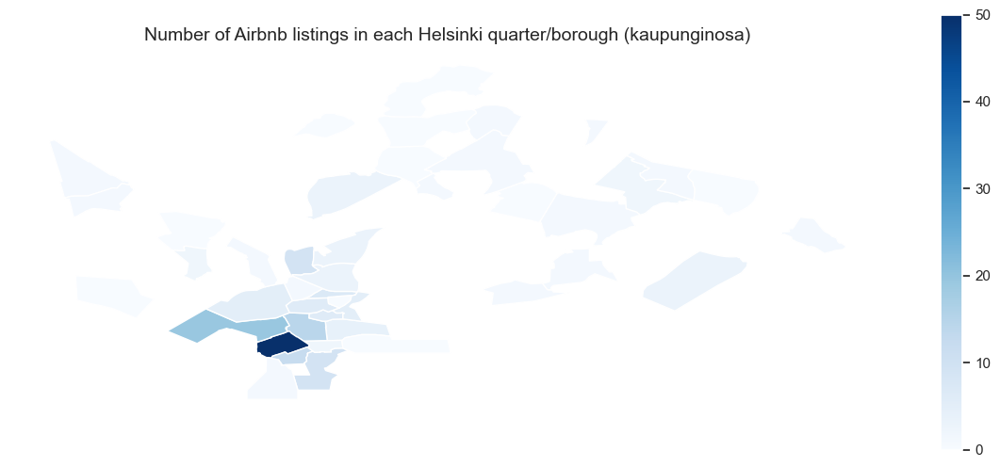

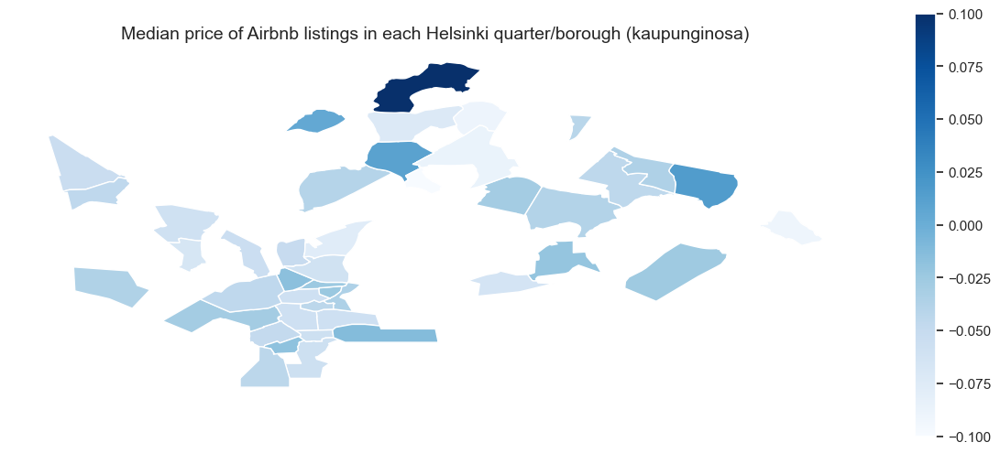

In [238]:
# Plotataan airbnb-asuntojen määrä kussakin kaupunginosassa
fig1, ax1 = plt.subplots(1, figsize=(15, 6))
kaupunginosa_map.plot(column='number_of_listings', cmap='Blues', ax=ax1)
ax1.axis('off')
ax1.set_title('Number of Airbnb listings in each Helsinki quarter/borough (kaupunginosa)', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=0, vmax=50))
sm._A = [] # Creates an empty array for the data range
cbar = fig1.colorbar(sm)
plt.show()

# Plotting the median price of listings in each borough
fig2, ax2 = plt.subplots(1, figsize=(15, 6))
kaupunginosa_map.plot(column='median_price', cmap='Blues', ax=ax2)
ax2.axis('off')
ax2.set_title('Median price of Airbnb listings in each Helsinki quarter/borough (kaupunginosa)', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=min(kaupunginosa_map.median_price), vmax=max(kaupunginosa_map.median_price)))
sm._A = [] # Creates an empty array for the data range
cbar = fig2.colorbar(sm)
plt.show()

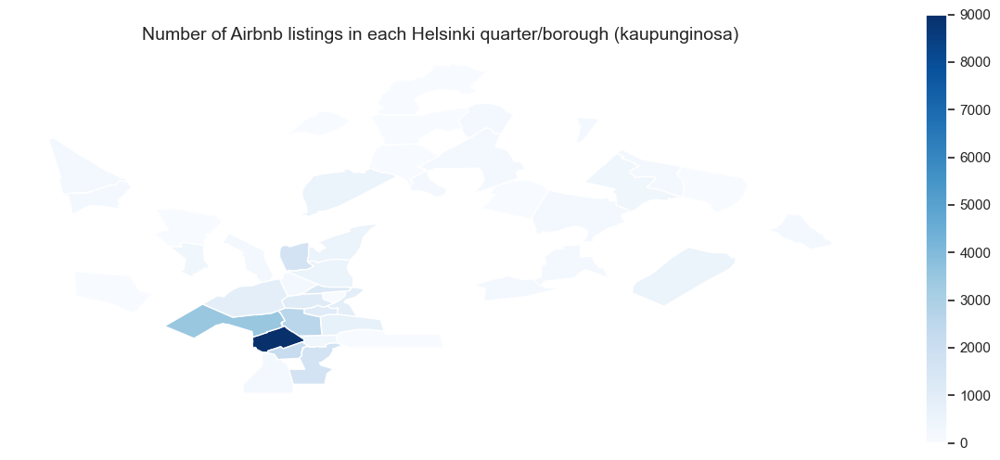

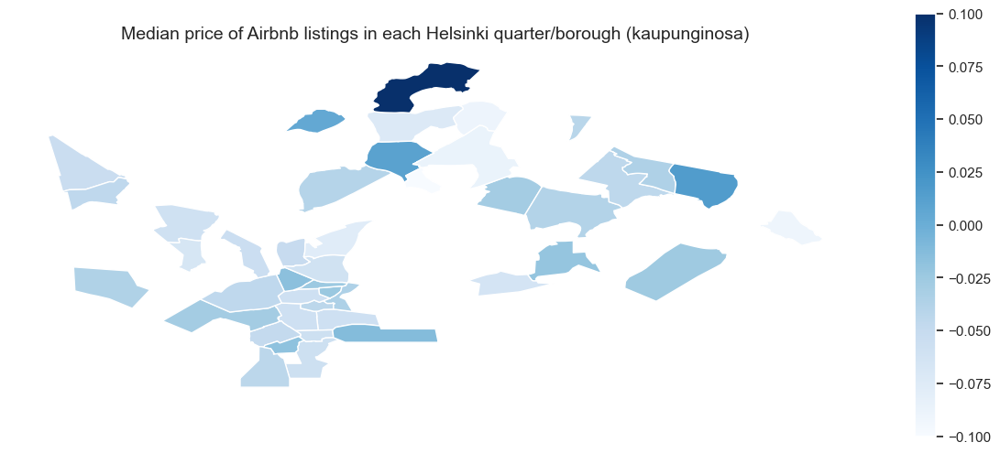

In [239]:
# Plotting the number of listings in each borough
fig1, ax1 = plt.subplots(1, figsize=(15, 6))
kaupunginosa_map.plot(column='number_of_listings', cmap='Blues', ax=ax1)
ax1.axis('off')
ax1.set_title('Number of Airbnb listings in each Helsinki quarter/borough (kaupunginosa)', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=0, vmax=9000))
sm._A = [] # Creates an empty array for the data range
cbar = fig1.colorbar(sm)
plt.show()

# Plotting the median price of listings in each borough
fig2, ax2 = plt.subplots(1, figsize=(15, 6))
kaupunginosa_map.plot(column='median_price', cmap='Blues', ax=ax2)
ax2.axis('off')
ax2.set_title('Median price of Airbnb listings in each Helsinki quarter/borough (kaupunginosa)', fontsize=14)
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=min(kaupunginosa_map.median_price), vmax=max(kaupunginosa_map.median_price)))
sm._A = [] # Creates an empty array for the data range
cbar = fig2.colorbar(sm)
plt.show()

# Current dataframe saved to csv


In [240]:
after_maps = df.to_csv(r'data/hy-after_maps.csv', index=id, header=True)

In [241]:
df = pd.read_csv('data/hy-after_maps.csv', index_col=0)

## Property and room types - what to do?

We probably don't need all the columns we currently have containing this information. Therefore, let's see which one might be the best one(s) to get rid of.

Let's see, how many rows we've in our dataset, so we can figure out, if any of the categories has nan-information

In [242]:
kaupunginosa_map.head()

,geometry,number_of_listings,median_price
paikkakunnat,,,
Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [243]:
len(df)

220

In [244]:
map_df.head()

,paikkakunnat,geometry
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [245]:
#kaupunginosa2 = kaupunginosa_map.copy()

In [246]:
#kaupunginosa2.rename(columns={'paikkakunnat': 'NIMI'}, inplace=True)

In [247]:
#kaupunginosa2.head()

In [248]:
#map_df = map_df.set_index('paikkakunnat')

In [249]:
#map_df

In [306]:
map_df
map_df3 = map_df.copy()

In [307]:
map_df3 = map_df3.set_index('paikkakunnat')

In [304]:
map_df.head()

,paikkakunnat,geometry
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [311]:
map_df3.rename(columns={'NIMI': 'paikkakunnat'}, inplace=True)

In [483]:
kaupunginosa_map

,geometry,number_of_listings,median_price
paikkakunnat,,,
Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5
Punavuori,"POLYGON Z ((24.92726 60.16047 0.00000, 24.9275...",13.0,121.0
Eira,"POLYGON Z ((24.93334 60.15757 0.00000, 24.9337...",NaN,NaN
Ullanlinna,"POLYGON Z ((24.93754 60.15321 0.00000, 24.9437...",10.0,76.0
Katajanokka,"POLYGON Z ((24.95772 60.16814 0.00000, 24.9590...",1.0,128.0


In [486]:
kaupunginosa_map2.head()

,NIMI,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",0.0,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5



### Ohjeet, joilla folium-juttu lopulta onnistui

[Linkki](https://vverde.github.io/blob/interactivechoropleth.html)

# Folium iframe-ohjeet:

 * Parhaalta vaikuttaneet [stackexchange-ohjeet](https://github.com/python-visualization/folium/issues/781) Linkki

In [489]:
skaala = (kaupunginosa_map2['number_of_listings'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()

In [490]:
skaala

[0.0, 0.0, 1.0, 4.0, 13.120000000000005, 50.0]

In [491]:
y_map = kaupunginosa_map2.centroid.y.mean()

In [493]:
x_map=kaupunginosa_map2.centroid.x.mean()

In [494]:
mymap = folium.Map(location=[y_map, x_map], zoom_start=11,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap)
mymap


In [694]:
skaala = (kaupunginosa_map2['number_of_listings'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()

In [690]:
mymap.choropleth(
    geo_data = kaupunginosa_map2,
    name='Choropleth',
    data=kaupunginosa_map2,
    columns=["NIMI", "number_of_listings"],
    key_on = "feature.properties.NIMI",
    fill_color ='YlGnBu',
    threshold_scale=skaala,
    fill_opacity=1,
    line_opacity=0.2,
    legend_name='Osuus Airbnb-asunnoista kaupunginosassa',
    smooth_factor=0
)

In [691]:
mymap

In [692]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}



In [587]:
kaupunginosat = folium.features.GeoJson(
    kaupunginosa_map2,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=["NIMI", "number_of_listings"],
        aliases=['Kaupunginosa: ', 'Airbnb-asuntoja/huoneita kaupunginosassa: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)

In [588]:
mymap.add_child(kaupunginosat)
mymap.keep_in_front(kaupunginosat)
folium.LayerControl().add_to(mymap)
mymap

In [650]:
import branca.colormap as cm

colormap = cm.linear.YlGnBu_09
colormap

In [700]:
colormap = cm.linear.YlGnBu_09.to_step(10)
colormap


kaupunginosa_map2.number_of_listings.quantiles()
#print(kaupunginosa_map2.number_of_listings/220)

AttributeError: 'Series' object has no attribute 'quantiles'

In [699]:
colormap = cm.linear.YlGnBu_09.to_step(data=kaupunginosa_map2['number_of_listings'], method='quant', quantiles=[0,0.004, 0.01, 0.05, 0.75,0.9,0.98,1])
colormap

In [514]:
kaupunginosa_map2.describe()

,number_of_listings,median_price
count,148.000000,43.000000
mean,1.486486,94.232558
std,4.937000,38.762609
min,0.000000,27.000000
25%,0.000000,75.000000
50%,0.000000,90.000000
75%,1.000000,110.500000
max,50.000000,256.000000


In [682]:
#colorscale2 = branca.colormap.linear.YlOrRd_09(index=[0, 1.0], vmin=0, vmax=220)
#colorscale2

In [683]:
#colorscale2 = branca.colormap.linear.YlOrRd_09.scale(index=[0, 0.vmin=0, vmax=220)
#colorscale2
#colorscale2 = cm.linear.YlGnBu_09.to_step(20)
#colorscale2

In [684]:
#colorscale3 = branca.colormap.linear.YlGnBu_09.scale(kaupunginosa_map2['number_of_listings'].min(), kaupunginosa_map2['number_of_listings'].max())
#colorscale3 = branca.colormap.linear.YlGnBu_09.scale(0.0, kaupunginosa_map2['number_of_listings'].max()).to_step(10)
#colorscale3
#colorscale3 = cm.linear.YlGnBu_09.to_step(10)

In [657]:
cm.linear.YlGnBu_09

In [660]:
colorscale2 = cm.linear.YlGnBu_09.to_step(10)
colorscale2

In [685]:
#(kaupunginosa_map2['number_of_listings'].value_counts())


In [577]:
kaupunginosa_map2.quantile(0.2, axis=0)

number_of_listings     0.0
median_price          72.8
Name: 0.2, dtype: float64

In [703]:
colormap = cm.linear.YlGnBu_09.to_step(data=kaupunginosa_map2['number_of_listings'], method='quant', quantiles=[0,0.003, 0.004, 0.1,0.75,0.9,0.98,1])#.1,0.2,0.3,1.0])
colormap

In [676]:
colormap = cm.linear.YlGnBu_09.to_step(data=kaupunginosa_map2['number_of_listings'], method='quant', quantiles=[0,0.002,0.003, 0.004, 0.08,.75,0.9,0.98,1])#,0.50, 0.60, 0.70, 0.80, 0.90, 1])
colormap
#kaupunginosa_map2['number_of_listings'].quantile((0,0.1,0.75,0.9,0.98,1))

## Kaupunginosamapin tallennus flaskissa käyttöä varten.

In [ ]:
kaupunginosa_map2.sa

In [704]:
mymap = folium.Map(location=[y_map, x_map], zoom_start=11,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap)
colormap.caption = "Airbnb-asuntoja/huoneita eri kaupunginosissa"
style_function = lambda x: {"weight":0.5, 
                            'color':'black',
                            #'threshold_scale':skaala,
                            'fillColor':colormap(x['properties']['number_of_listings']), 
                            #'fillColor':colorscale2(x['properties']['number_of_listings']),
                            #'fillColor':colorscale3(x['properties']['number_of_listings']),
                            'fillOpacity':0.75}
                            #'lineOpacity':0.5}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

kaupunginosat = folium.features.GeoJson(
    kaupunginosa_map2,
    style_function=style_function,
    control=False,
    highlight_function=highlight_function,
    tooltip=folium.features.GeoJsonTooltip(
        fields=["NIMI", "number_of_listings"],
        aliases=['Kaupunginosa: ', 'Airbnb-asuntoja/huoneita kaupunginosassa: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
        sticky=True
    )
)

colormap.add_to(mymap)
mymap.add_child(kaupunginosat)
mymap

mymap.save('flask/templates/number_of_listings_hel.html')
mymap

In [715]:
kaupunginosa_map2.fillna(0.0, inplace=True)

In [716]:
x_map=kaupunginosa_map2.centroid.x.mean()
y_map=kaupunginosa_map2.centroid.y.mean()
print(x_map,y_map)

mymap2 = folium.Map(location=[y_map, x_map], zoom_start=11,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap2)
mymap2


myscale2 = (kaupunginosa_map2['median_price'].quantile((0,0.1,0.75,0.9,0.98,1))).tolist()

mymap2.choropleth(
 geo_data=kaupunginosa_map2,
 name='Choropleth',
 data=kaupunginosa_map2,
 columns=['NIMI','median_price'],
 key_on="feature.properties.NIMI",
 fill_color='YlGnBu',
 threshold_scale=myscale2,
 fill_opacity=1,
 line_opacity=0.2,
 legend_name='Resident foreign population in %',
 smooth_factor=0
)
mymap2



24.989861535185558 60.208291540319266


In [718]:
style_function = lambda x: {'fillColor': '#ffffff', 
                            'color':'#000000', 
                            'fillOpacity': 0.1, 
                            'weight': 0.1}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}

kaupunginosat2 = folium.features.GeoJson(
    kaupunginosa_map2,
    style_function=style_function, 
    control=False,
    highlight_function=highlight_function, 
    tooltip=folium.features.GeoJsonTooltip(
        fields=['NIMI','median_price'],
        aliases=['Kaupunginosa: ','Kaupunginosan mediaanihinta: '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;") 
    )
)
mymap2.add_child(kaupunginosat2)
mymap2.keep_in_front(kaupunginosat2)
folium.LayerControl().add_to(mymap2)
mymap2

In [720]:
colormap = cm.linear.YlGnBu_09
colormap

In [721]:
colormap = cm.linear.YlGnBu_09.to_step(10)
colormap

In [722]:
colormap = cm.linear.YlGnBu_09.to_step(data=kaupunginosa_map2['median_price'], method='quant', quantiles=[0,0.1,0.75,0.9,0.98,1])
colormap

In [726]:
mymap2 = folium.Map(location=[y_map, x_map], zoom_start=11, tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap2)
colormap.caption = "Kaupunginosan mediaanihinta"
style_function = lambda x: {"weight":0.5, 
                            'color':'black', 
                            'fillColor':colormap(x['properties']['median_price']),
                            'fillOpacity': 0.75}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
kaupunginosat2=folium.features.GeoJson(
        kaupunginosa_map2,
        style_function=style_function,
        control=False,
        highlight_function=highlight_function,
        tooltip=folium.features.GeoJsonTooltip(fields=['NIMI','median_price'],
            aliases=['Kaupunginosa: ','Kaupunginosan mediaanihinta: '],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
            sticky=True
        )
    )
colormap.add_to(mymap2)
mymap2.add_child(kaupunginosat2)

mymap2.save('flask/templates/median_price_hel.html')
mymap2

In [705]:
kaupunginosa_map2.head()

,NIMI,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",0.0,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [ ]:
mymap2 = folium.Map(location=[y_map, x_map], zoom_start=11,tiles=None)
folium.TileLayer('CartoDB positron',name="Light Map",control=False).add_to(mymap2)
colormap.caption = "% of foreign resident population"
style_function = lambda x: {"weight":0.5, 
                            'color':'black',
                            'fillColor':colormap(x['properties']['median_price']), 
                            'fillOpacity':0.75}
highlight_function = lambda x: {'fillColor': '#000000', 
                                'color':'#000000', 
                                'fillOpacity': 0.50, 
                                'weight': 0.1}
kaupunginosien_hinnat=folium.features.GeoJson(
        kaupunginosa_map2,
        style_function=style_function,
        control=False,
        highlight_function=highlight_function,
        tooltip=folium.features.GeoJsonTooltip(fields=['NIMI','median_price'],
            aliases=['Kaupunginosien mediaanihinnat'],
            style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;"),
            sticky=True
        )
    )
colormap.add_to(mymap2)
mymap2.add_child(kaupunginosien_hinnat)
mymap2

### Airbnb-asuntojen määrät eri kaupunginosissa kartalle

In [499]:
mymap.choropleth(
    geo_data = kaupunginosa_map2,
    name='Choropleth',
    data=kaupunginosa_map2,
    columns=["NIMI", "number_of_listings"],
    key_on = "feature.properties.NIMI",
    fill_color ='YlGnBu',
    threshold_scale=skaala,
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Osuus Airbnb-asunnoista kaupunginosassa',
    smooth_factor=0
)


In [500]:
mymap

In [496]:
kaupunginosa_map2.head()

,NIMI,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",0.0,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [505]:
import branca.colormap as cm
colormap = cm.linear.YlGnBu_09.to_step(10)

NameError: name 'cm' is not defined

In [313]:
kaupunginosa_map2.head()

,paikkakunnat,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [314]:
kaupunginosa_map2.rename(columns={'paikkakunnat': 'NIMI'}, inplace=True)

In [317]:
kaupunginosa_map2.head()

,NIMI,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [318]:
map_df.head()

,paikkakunnat,geometry
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643..."
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511..."
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350..."
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422..."
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207..."


In [336]:
#kaupunginosa_map2
#kaupunginosa_map2.number_of_listings.fillna(0.0, inplace=True)

In [337]:
#kaupunginosa2.head()

,geometry,number_of_listings,median_price
paikkakunnat,,,
Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [ ]:
"""
import branca

#osaalueet = 'https://raw.githubusercontent.com/dhh16/helsinki/master/osaalueet.geojson'
osaalueet = r'data/osaalueet.geojson'

colorscale = branca.colormap.linear.YlOrRd_09.scale(0, 50e3)

#def style_function(feature):
    
m = folium.Map(location=[60.11021, 24.7385046], zoom_start=11)


#kaupunginosa_map2
#map_df


folium.Choropleth(
    #geo_data = kaupunginosa_map['geometry'],
    #location=[]
    geo_data = osaalueet,
    #geo_data = map_df3,
    name = 'choropleth',
    data = kaupunginosa_map2,
    columns = ['NIMI', 'number_of_listings'],
    key_on='feature.properties.Name',
    fill_color='YlGn',
    fill_opacity=1,
    line_opacity=1,
    smooth_factor=0
    #legend_name='Unemployment Rate (%)'
#).add_to(m)


#colormap = linear.YlGn_09.scale(
    

#folium.LayerControl().add_to(m)
#m
"""

In [333]:
kaupunginosa_map2.head()

,NIMI,geometry,number_of_listings,median_price
0,Itäkeskus,"POLYGON Z ((25.06433 60.20774 0.00000, 25.0643...",NaN,NaN
1,Kruununhaka,"POLYGON Z ((24.95038 60.17638 0.00000, 24.9511...",5.0,75.0
2,Kluuvi,"POLYGON Z ((24.93208 60.17891 0.00000, 24.9350...",15.0,75.0
3,Kaartinkaupunki,"POLYGON Z ((24.94121 60.16772 0.00000, 24.9422...",3.0,76.0
4,Kamppi,"POLYGON Z ((24.92064 60.16483 0.00000, 24.9207...",50.0,85.5


In [250]:
df.head()

,id,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,host_verified,is_business_travel_ready,is_new_listing,is_super_host,kicker_content_message,latitude,localized_city,reviews_scores_location,longitude,max_nights,min_nights,monthly_price_factor,name,person_capacity,picture_count,price_string,...,response_time,review_count,reviews_scores_rating,reviews_count,room_and_property_type,room_type,room_type_category,space_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,paikkakunnat,NIMI
0,22858494,NaN,1.0,1.0,0.0,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,0,0,0,Entire apartment,60.16708,Helsingfors,NaN,24.93492,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,2,17,38,...,within an hour,NaN,NaN,365,Entire apartment,Entire home/apt,entire_home,Entire apartment,3.6-4.4/5.0,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Kamppi,Kamppi
1,16501244,NaN,1.0,1.0,0.0,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,0,0,1,Entire condominium,60.16653,Helsinki,NaN,24.93362,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",7,22,58,...,within an hour,NaN,NaN,327,Entire condominium,Entire home/apt,entire_home,Entire condominium,4.5-5.0/5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,Kamppi,Kamppi
2,28982354,NaN,1.0,1.0,0.0,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,0,0,1,Shared room,60.15867,Helsinki,NaN,24.94423,6,1,0.0,Shared apartment near the city center and the sea,3,3,26,...,within an hour,NaN,NaN,115,Shared room in apartment,Shared room,shared_room,Shared room,4.5-5.0/5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,Siltasaari,Siltasaari
3,41969547,NaN,1.0,1.0,0.0,NaN,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,0,0,1,0,Hostel beds,60.17884,Helsinki,NaN,24.95787,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,1,14,24,...,within an hour,NaN,NaN,2,Shared room in hostel,Shared room,shared_room,Hostel beds,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,Kamppi,Kamppi
4,42901953,NaN,1.0,1.0,0.0,NaN,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,0,0,1,0,Entire apartment,60.16563,Helsingfors,NaN,24.92996,1125,1,0.9,Beautiful apartment in the Centre Helsinki.,4,13,55,...,within a few hours,NaN,NaN,1,Entire apartment,Entire home/apt,entire_home,Entire apartment,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,Linjat,Linjat


In [256]:

df.isna().sum()

id                               0
reviews_scores_accuracy         44
allows_children                  0
allows_infants                   0
allows_pets                      0
reviews_scores_avg_rating       45
bathrooms                        0
bedrooms                         0
beds                             0
can_instant_book                 0
cancel_policy                    0
reviews_scores_checkin          44
city                             0
cleaning_fee                     0
reviews_scores_cleanliness      44
reviews_scores_communication    44
host_verified                    0
is_business_travel_ready         0
is_new_listing                   0
is_super_host                    0
kicker_content_message           0
latitude                         0
localized_city                   0
reviews_scores_location         44
longitude                        0
max_nights                       0
min_nights                       0
monthly_price_factor             0
name                

we can see that room_and_property_type contains nan-values, which we don't want here. Of the ones remaining, **room_type** and **room_type_category** seem to contain the same information, but **room_type**'s types are named in a slightly more humane fashion, so we'll use it

In [257]:
df.drop(['kicker_content_message', 'space_type', 'room_type_category', 'room_and_property_type'], axis=1, inplace=True)

In [258]:
# Now added to the above cell
df.drop(['room_and_property_type'], axis=1, inplace=True)

KeyError: "['room_and_property_type'] not found in axis"

In [259]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 220 entries, 0 to 219
Data columns (total 62 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            220 non-null    int64  
 1   reviews_scores_accuracy       176 non-null    object 
 2   allows_children               220 non-null    float64
 3   allows_infants                220 non-null    float64
 4   allows_pets                   220 non-null    float64
 5   reviews_scores_avg_rating     175 non-null    object 
 6   bathrooms                     220 non-null    float64
 7   bedrooms                      220 non-null    float64
 8   beds                          220 non-null    float64
 9   can_instant_book              220 non-null    int64  
 10  cancel_policy                 220 non-null    object 
 11  reviews_scores_checkin        176 non-null    object 
 12  city                          220 non-null    object 
 13  clean

### Muuta

In [260]:
df.drop(['longitude', 'latitude'], axis=1, inplace=True)

In [261]:
df.drop(['localized_city'],axis=1, inplace=True)

In [262]:
df.drop(['NIMI'], axis=1, inplace=True)

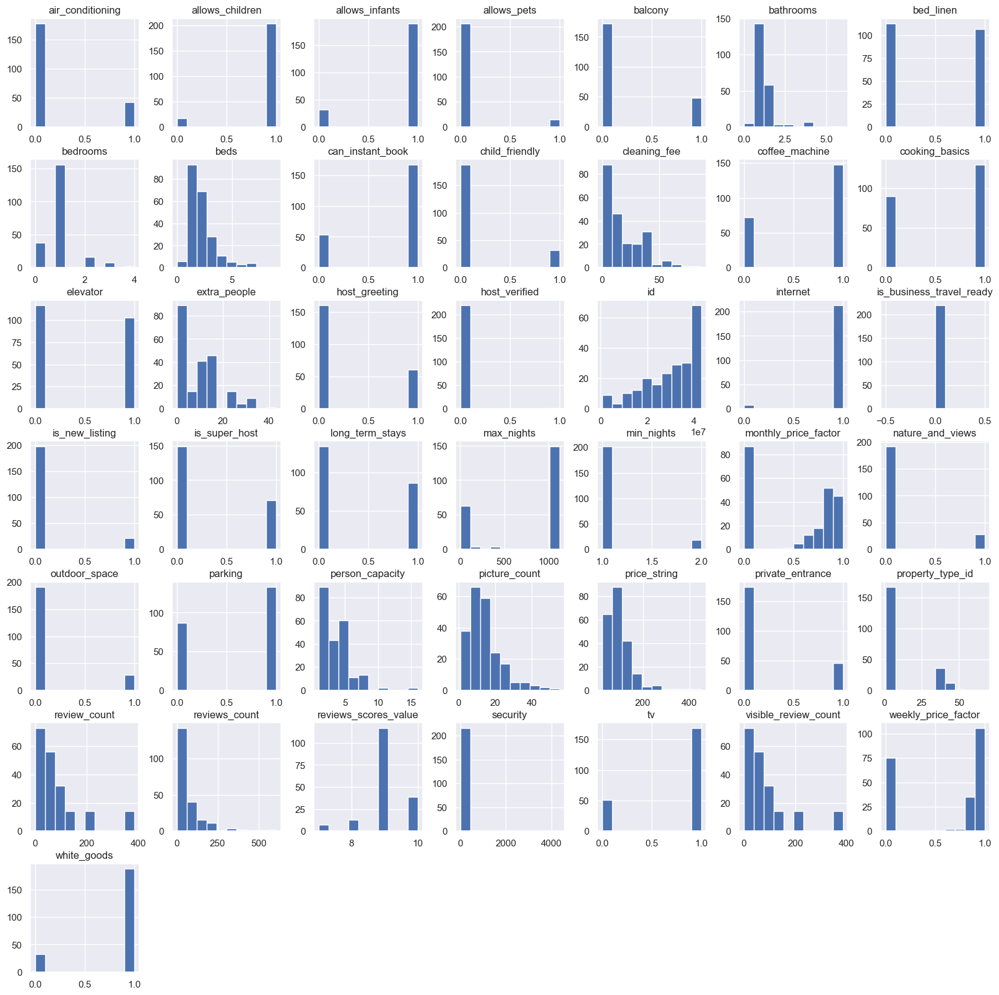

In [263]:

# Replacing columns with f/t with 0/1
df.replace({'f': 0, 't': 1}, inplace=True)

# Plotting the distribution of numerical and boolean categories
df.hist(figsize=(20,20));

In [264]:
df.drop(['host_verified', 'is_business_travel_ready'], axis=1, inplace=True)

In [268]:
df.internet.value_counts()

1.0    213
0.0      7
Name: internet, dtype: int64

In [269]:
def category_count_plot(col, figsize=(8,4)):
    """
    Plots a simple bar chart of the total count for each category in the column specified.
    A figure size can optionally be specified.
    """
    plt.figure(figsize=figsize)
    df[col].value_counts().plot(kind='bar')
    plt.title(col)
    plt.xticks(rotation=0)
    plt.show()

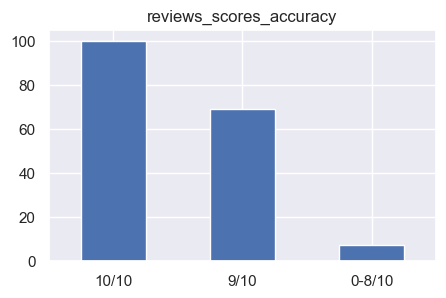

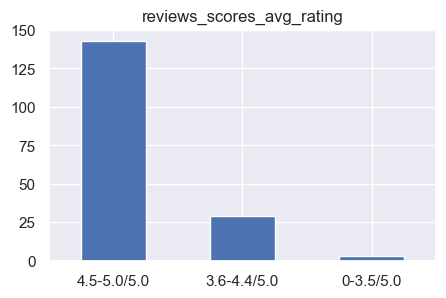

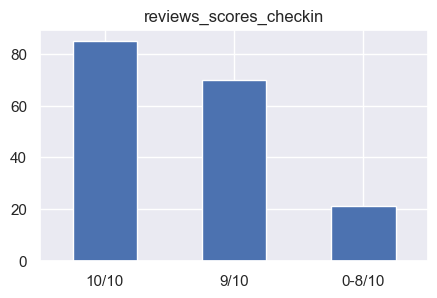

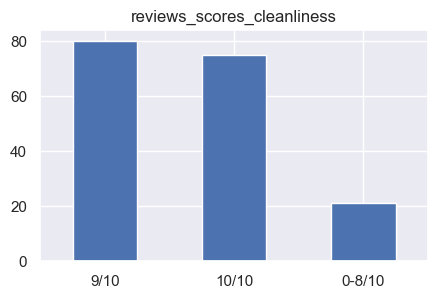

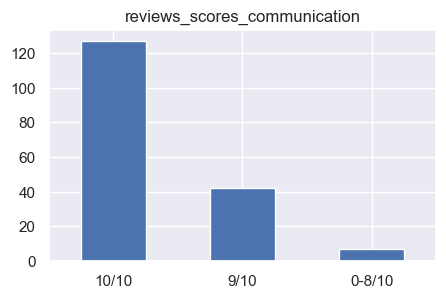

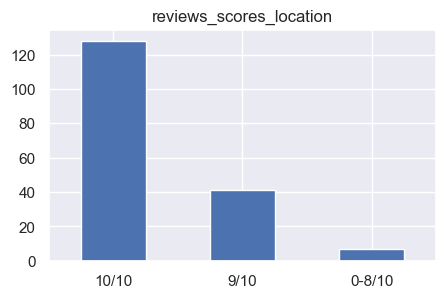

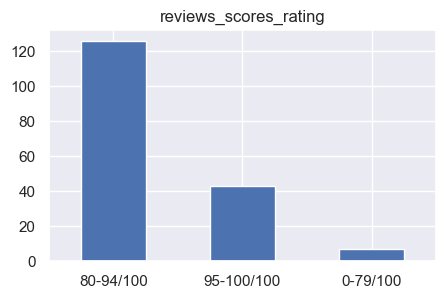

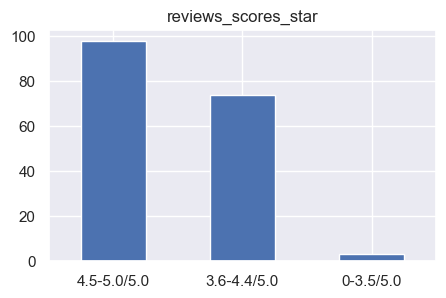

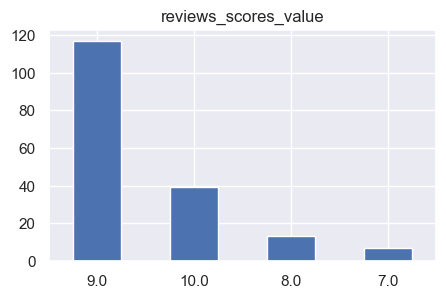

In [270]:
for col in list(df.columns[df.columns.str.startswith("reviews_scores") == True]):
    category_count_plot(col, figsize=(5,3))

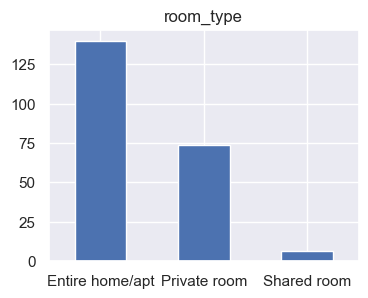

Entire home/apt    0.636364
Private room       0.336364
Shared room        0.027273
Name: room_type, dtype: float64


In [271]:

for col in ['room_type']:
    category_count_plot(col, figsize=(4,3))
    print(df[col].value_counts(normalize=True))

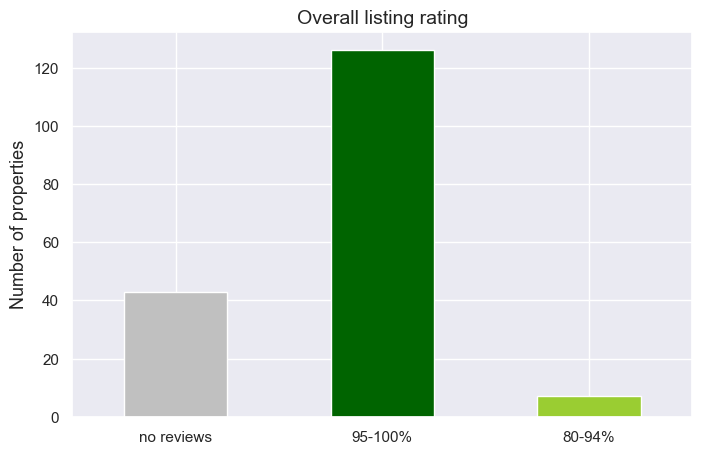

In [272]:
fig, ax = plt.subplots(1, 1, figsize=(8,5))
ax.set_title('Overall listing rating', fontsize=14)
df['reviews_scores_rating'].value_counts().sort_index(ascending=False).plot(kind='bar', color=['silver', 'darkgreen', 'yellowgreen', '#d1f28a' ], ax=ax)
ax.set_xticklabels(labels=['no reviews', '95-100%', '80-94%', '0-79%'], rotation=0)
ax.set_xlabel('')
ax.set_ylabel('Number of properties', fontsize=13)
plt.show()

In [273]:
def binary_count_and_price_plot(col, figsize=(8,3)):
    """
    Plots a simple bar chart of the counts of true and false categories in the column specified,
    next to a bar chart of the median price for each category.
    A figure size can optionally be specified.
    """
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=figsize)
    fig.suptitle(col, fontsize=16, y=1)
    plt.subplots_adjust(top=0.80) # So that the suptitle does not overlap with the ax plot titles
    
    df.groupby(col).size().plot(kind='bar', ax=ax1, color=['firebrick', 'seagreen'])
    ax1.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax1.set_title('Category count')
    ax1.set_xlabel('')
    
    df.groupby(col).price_string.median().plot(kind='bar', ax=ax2, color=['firebrick', 'seagreen'])
    ax2.set_xticklabels(labels=['false', 'true'], rotation=0)
    ax2.set_title('Median price (€)')
    ax2.set_xlabel('')
    
    plt.show()

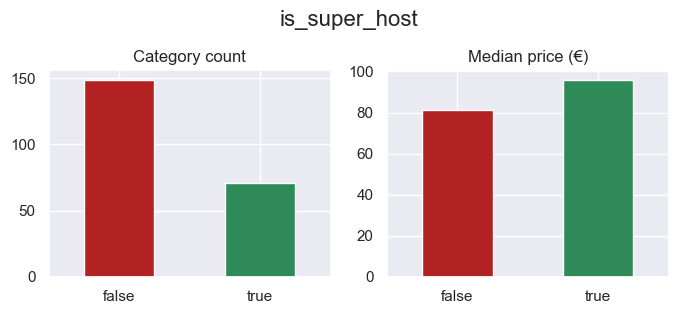

0    0.677273
1    0.322727
Name: is_super_host, dtype: float64


In [274]:
binary_count_and_price_plot('is_super_host')
print(df.is_super_host.value_counts(normalize=True))

In [275]:
df.head()

,id,reviews_scores_accuracy,allows_children,allows_infants,allows_pets,reviews_scores_avg_rating,bathrooms,bedrooms,beds,can_instant_book,cancel_policy,reviews_scores_checkin,city,cleaning_fee,reviews_scores_cleanliness,reviews_scores_communication,is_new_listing,is_super_host,reviews_scores_location,max_nights,min_nights,monthly_price_factor,name,person_capacity,picture_count,price_string,property_type_id,response_rate,response_time,review_count,reviews_scores_rating,reviews_count,room_type,reviews_scores_star,reviews_scores_value,visible_review_count,weekly_price_factor,extra_people,security,air_conditioning,balcony,nature_and_views,bed_linen,tv,coffee_machine,cooking_basics,white_goods,elevator,child_friendly,parking,outdoor_space,host_greeting,internet,long_term_stays,private_entrance,paikkakunnat
0,22858494,NaN,1.0,1.0,0.0,4.5-5.0/5.0,0.5,0.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,0,NaN,1125,1,0.0,SPACIOUS AND SIMPLE IN THE HEART OF HELSINKI 26m2,2,17,38,1.0,100%,within an hour,NaN,NaN,365,Entire home/apt,3.6-4.4/5.0,NaN,NaN,0.90,0,0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Kamppi
1,16501244,NaN,1.0,1.0,0.0,4.5-5.0/5.0,1.5,1.0,3.0,0,CANCEL_MODERATE,NaN,Helsinki,0,NaN,NaN,0,1,NaN,60,1,0.8,"Cozy super central 60m2 family apartment, Netflix",7,22,58,37.0,100%,within an hour,NaN,NaN,327,Entire home/apt,4.5-5.0/5.0,NaN,NaN,0.88,8,217,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,Kamppi
2,28982354,NaN,1.0,1.0,0.0,4.5-5.0/5.0,1.0,1.0,1.0,1,CANCEL_STRICT_14_WITH_GRACE_PERIOD,NaN,Helsinki,0,NaN,NaN,0,1,NaN,6,1,0.0,Shared apartment near the city center and the sea,3,3,26,1.0,50-89%,within an hour,NaN,NaN,115,Shared room,4.5-5.0/5.0,NaN,NaN,0.00,0,0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,Siltasaari
3,41969547,NaN,1.0,1.0,0.0,NaN,4.0,1.0,1.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,0,NaN,NaN,1,0,NaN,1125,1,0.0,№11· Hostel INNTOURIST in the CENTER of Helsinki,1,14,24,45.0,100%,within an hour,NaN,NaN,2,Shared room,NaN,NaN,NaN,0.00,0,0,1.0,0.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,1.0,0.0,Kamppi
4,42901953,NaN,1.0,1.0,0.0,NaN,1.0,1.0,2.0,1,CANCEL_FLEXIBLE,NaN,Helsinki,11,NaN,NaN,1,0,NaN,1125,1,0.9,Beautiful apartment in the Centre Helsinki.,4,13,55,1.0,100%,within a few hours,NaN,NaN,1,Entire home/apt,NaN,NaN,NaN,0.90,0,2173,0.0,0.0,0.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,Linjat


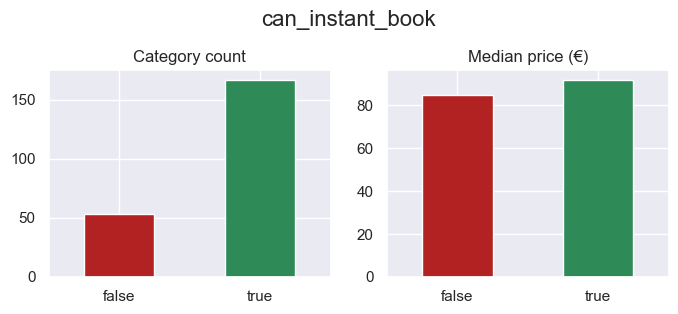

1    0.759091
0    0.240909
Name: can_instant_book, dtype: float64


In [276]:
binary_count_and_price_plot('can_instant_book')
print(df.can_instant_book.value_counts(normalize=True))

#### Amenities

The first one of the amenities we ended up storing is air conditioning, so let's figure its index. We also need to find the index of 'paikkakunnat', because that is not
part of amenities

In [277]:
df.columns.get_loc("air_conditioning")

39

In [287]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 220 entries, 0 to 219
Data columns (total 56 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   id                            220 non-null    int64  
 1   reviews_scores_accuracy       176 non-null    object 
 2   allows_children               220 non-null    float64
 3   allows_infants                220 non-null    float64
 4   allows_pets                   220 non-null    float64
 5   reviews_scores_avg_rating     175 non-null    object 
 6   bathrooms                     220 non-null    float64
 7   bedrooms                      220 non-null    float64
 8   beds                          220 non-null    float64
 9   can_instant_book              220 non-null    int64  
 10  cancel_policy                 220 non-null    object 
 11  reviews_scores_checkin        176 non-null    object 
 12  city                          220 non-null    object 
 13  clean

In [278]:
df.columns.get_loc('paikkakunnat')

55

In [288]:
df.drop(['name'], axis=1, inplace=True)

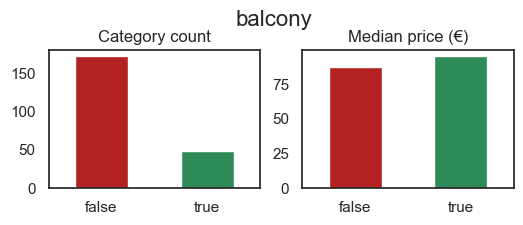

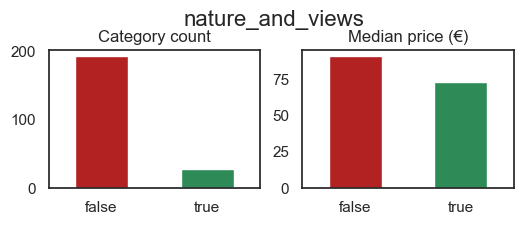

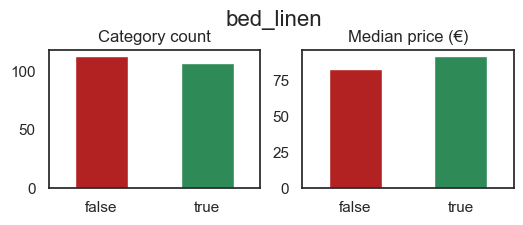

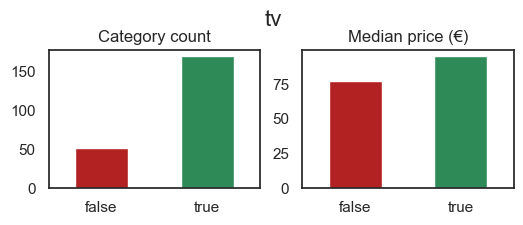

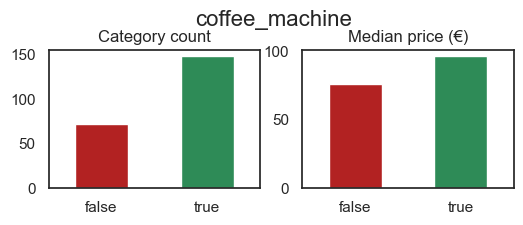

...

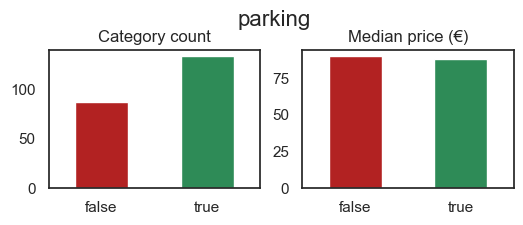

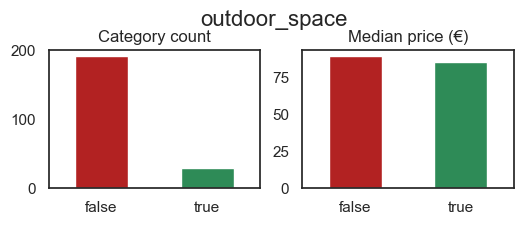

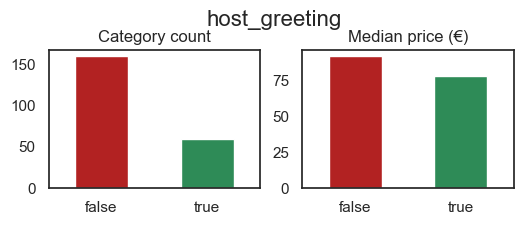

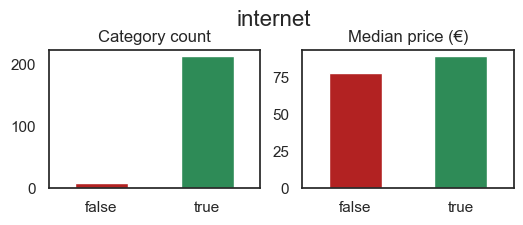

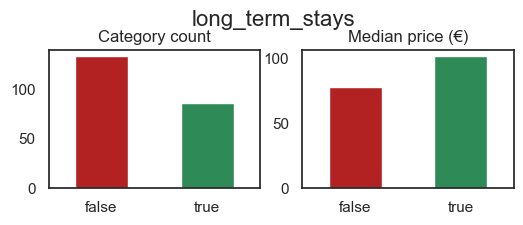

In [289]:
for col in df.iloc[:,39:-2].columns:
    binary_count_and_price_plot(col, figsize=(6,2))

# Preparing for modeling

In [290]:
transformed_df = pd.get_dummies(df)

In [291]:
transformed_df.columns

Index(['id', 'allows_children', 'allows_infants', 'allows_pets', 'bathrooms',
       'bedrooms', 'beds', 'can_instant_book', 'cleaning_fee',
       'is_new_listing',
       ...
       'paikkakunnat_Siltasaari', 'paikkakunnat_Taka-Töölö',
       'paikkakunnat_Tapanila', 'paikkakunnat_Tapaninvainio',
       'paikkakunnat_Torkkelinmäki', 'paikkakunnat_Torpparinmäki',
       'paikkakunnat_Ullanlinna', 'paikkakunnat_Vallila',
       'paikkakunnat_Vesala', 'paikkakunnat_Vilhonvuori'],
      dtype='object', length=123)

In [292]:
transformed_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 220 entries, 0 to 219
Columns: 123 entries, id to paikkakunnat_Vilhonvuori
dtypes: float64(28), int64(13), uint8(82)
memory usage: 89.8 KB


In [293]:
#transformed_df.drop(['name'],axis=1 ,inplace=True)

In [294]:
def multi_collinearity_heatmap(df, figsize=(11,9)):
    
    """
    Creates a heatmap of correlations between features in the df. A figure size can optionally be set.
    """
    
    # Set the style of the visualization
    sns.set(style="white")

    # Create a covariance matrix
    corr = df.corr()

    # Generate a mask the size of our covariance matrix
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=figsize)

    # Generate a custom diverging colormap
    cmap = sns.diverging_palette(220, 10, as_cmap=True)

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap=cmap, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5}, vmax=corr[corr != 1.0].max().max());

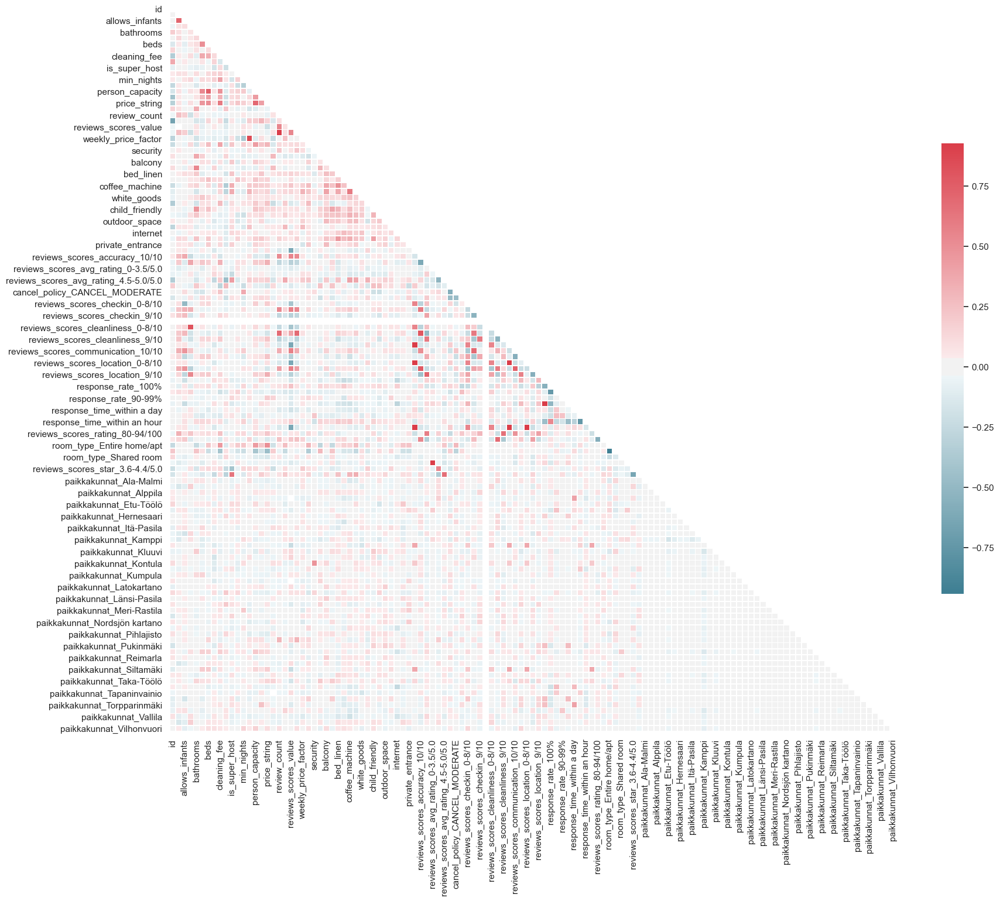

In [295]:
multi_collinearity_heatmap(transformed_df, figsize=(20,20))

## Tallennus - HUOM!

In [454]:
ennen_mallinnusta = df.to_csv(r'data/hy-ennen_mallinnusta.csv', index=id, header=True)

In [136]:
#df = pd.read_csv('data/hy-ennen_mallinnusta_1.csv', index_col=0)
df = pd.read_csv('data/hy-ennen_mallinnusta.csv', index_col=0)

In [298]:
to_drop = ['beds',
          'bedrooms',
          'response_rate_0-49%',
          'id']
to_drop.extend(list(transformed_df.columns[transformed_df.columns.str.endswith('nan')]))

In [299]:
transformed_df.drop(to_drop, axis=1, inplace=True)

In [301]:
transformed_df.drop(['visible_review_count', 'review_count', 'city_Helsinki'], axis=1, inplace=True)

KeyError: "['visible_review_count' 'review_count' 'city_Helsinki'] not found in axis"

In [302]:
transformed_df.drop(['property_type_id'], axis=1, inplace=True)

In [303]:
transformed_df.isna().sum()

id                                                   0
allows_children                                      0
allows_infants                                       0
allows_pets                                          0
bathrooms                                            0
can_instant_book                                     0
cleaning_fee                                         0
is_new_listing                                       0
is_super_host                                        0
max_nights                                           0
min_nights                                           0
monthly_price_factor                                 0
person_capacity                                      0
picture_count                                        0
price_string                                         0
reviews_count                                        0
reviews_scores_value                                44
weekly_price_factor                                  0
extra_peop

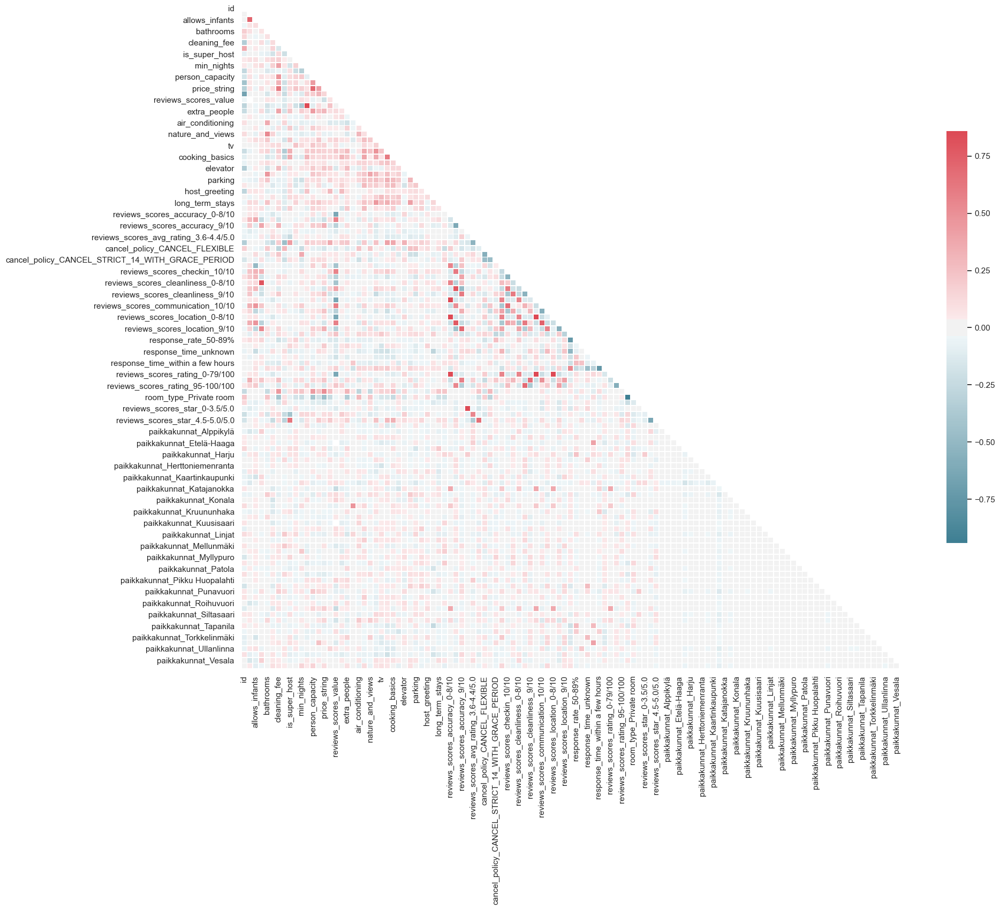

In [304]:
multi_collinearity_heatmap(transformed_df, figsize=(20,20))

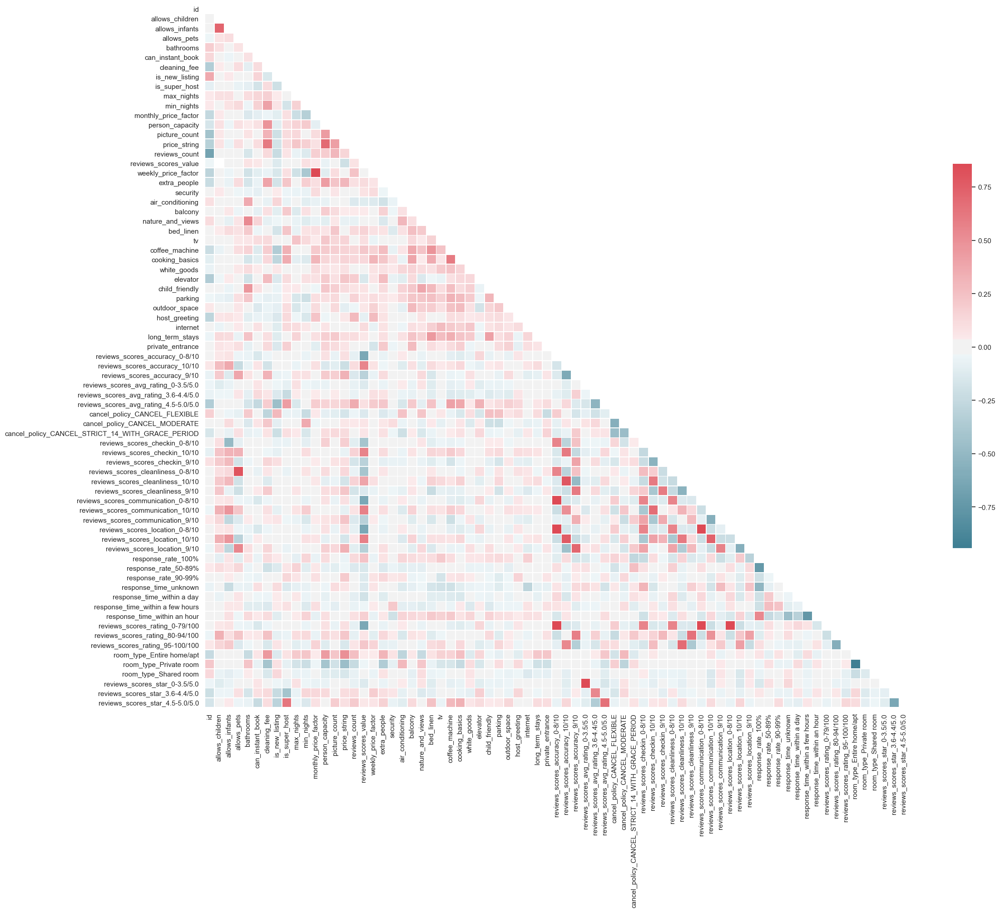

In [305]:
# Final assessment of multi-collinearity
multi_collinearity_heatmap(transformed_df.drop(list(transformed_df.columns[transformed_df.columns.str.startswith('paikkakunnat')]), axis=1), figsize=(25,22))

#### Reviews

There are some strong seeming correlations between highly rated properties etc. in different rating/review categories, most likely because a property that gets a good rating for one category, it is likely to get a high rating in other categories as well.

They'll be left in for now and possibly removed later, when optimizing my machine learning model

In [306]:
transformed_df.columns

Index(['id', 'allows_children', 'allows_infants', 'allows_pets', 'bathrooms',
       'can_instant_book', 'cleaning_fee', 'is_new_listing', 'is_super_host',
       'max_nights',
       ...
       'paikkakunnat_Siltasaari', 'paikkakunnat_Taka-Töölö',
       'paikkakunnat_Tapanila', 'paikkakunnat_Tapaninvainio',
       'paikkakunnat_Torkkelinmäki', 'paikkakunnat_Torpparinmäki',
       'paikkakunnat_Ullanlinna', 'paikkakunnat_Vallila',
       'paikkakunnat_Vesala', 'paikkakunnat_Vilhonvuori'],
      dtype='object', length=116)

In [307]:
#df.isna().sum()

In [308]:
#df['review_count']

In [309]:
transformed_df.isna().sum()

id                                                   0
allows_children                                      0
allows_infants                                       0
allows_pets                                          0
bathrooms                                            0
can_instant_book                                     0
cleaning_fee                                         0
is_new_listing                                       0
is_super_host                                        0
max_nights                                           0
min_nights                                           0
monthly_price_factor                                 0
person_capacity                                      0
picture_count                                        0
price_string                                         0
reviews_count                                        0
reviews_scores_value                                44
weekly_price_factor                                  0
extra_peop

In [310]:
numerical_columns = ['person_capacity', 'bathrooms',
                     'cleaning_fee', 'extra_people', 
                     'max_nights', 'min_nights', 
                     'reviews_count', 'price_string', 'security',
                     'monthly_price_factor', 'weekly_price_factor',
                     'picture_count']

In [311]:
#df.isna().sum()

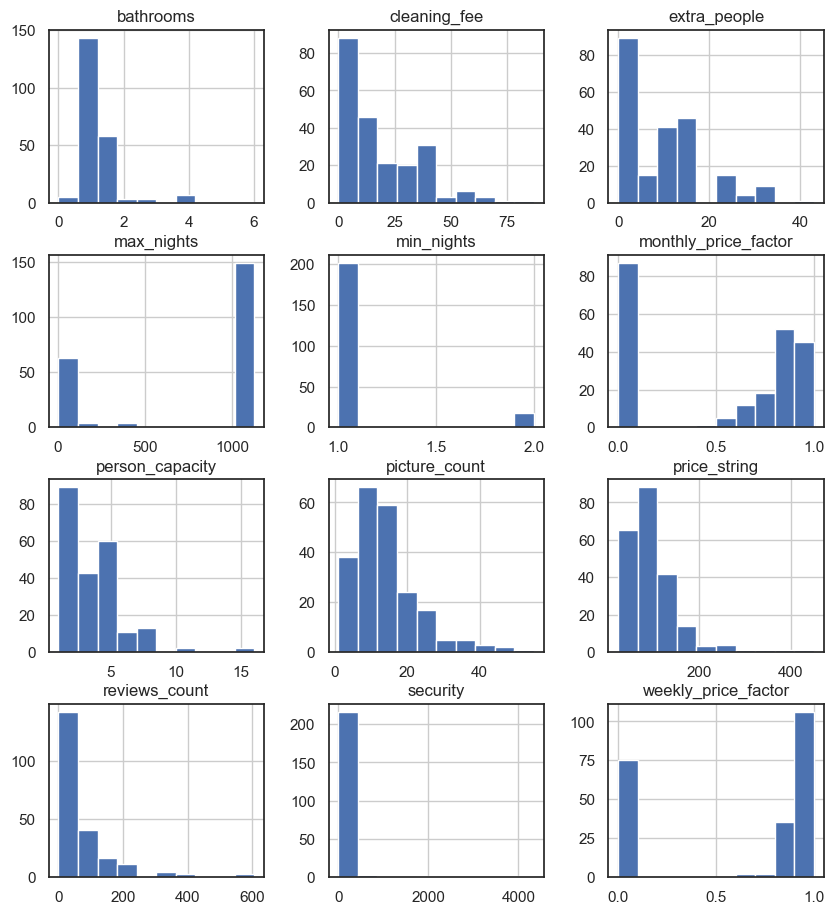

In [312]:
transformed_df[numerical_columns].hist(figsize=(10,11));

In [313]:
# Log transforming columns
numerical_columns = [i for i in numerical_columns if i not in ['availability_90', 'host_days_active']] # Removing items not to be transformed

for col in numerical_columns:
    transformed_df[col] = transformed_df[col].astype('float64').replace(0.0, 0.01) # Replacing 0s with 0.01
    transformed_df[col] = np.log(transformed_df[col])

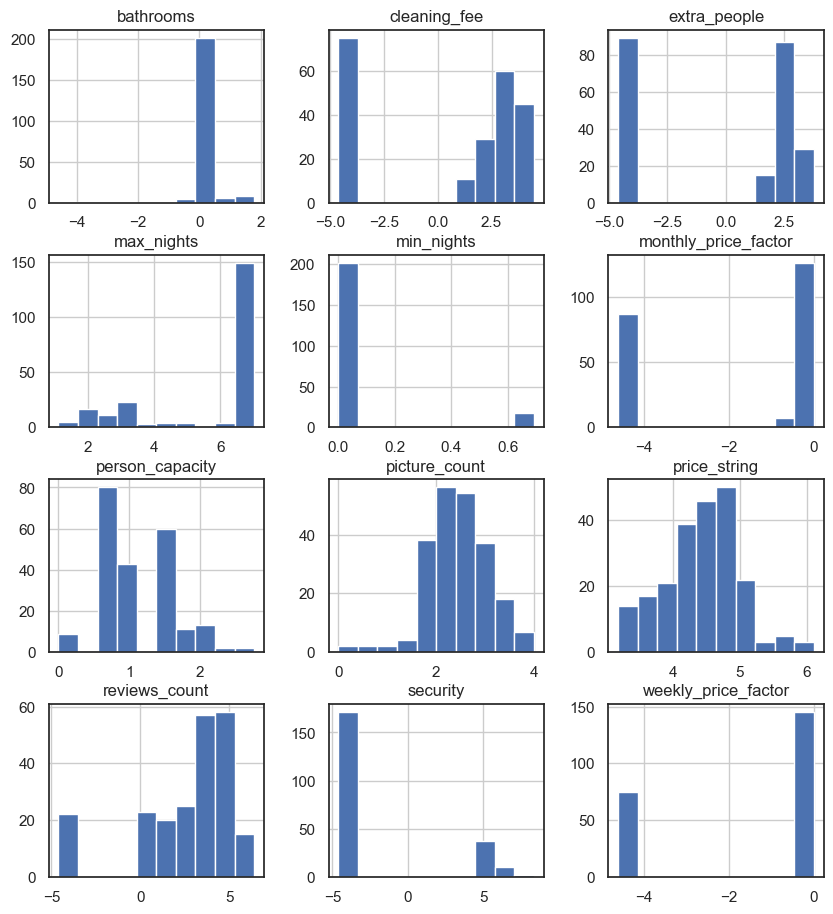

In [314]:

transformed_df[numerical_columns].hist(figsize=(10,11));

# Transformed_df talennettunna 

In [474]:
transformeddf = df.to_csv(r'data/hy-transformeddf.csv', index=id, header=True)


In [475]:
import pandas as pd
transformed_df = pd.read_csv('data/hy-transformeddf.csv', index_col=0)

In [315]:
# Separating X and y
X = transformed_df.drop('price_string', axis=1)
y = transformed_df.price_string

# Scaling
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

In [316]:
# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

# Gradient boosting, gracecarillo model2

In [317]:
xgb_reg_start = time.time()

xgb_reg_grace = xgb.XGBRegressor()
xgb_reg_grace.fit(X_train, y_train)
training_preds_xgb_reg = xgb_reg_grace.predict(X_train)
val_preds_xgb_reg = xgb_reg_grace.predict(X_test)

xgb_reg_end = time.time()

print(f"Time taken to run: {round((xgb_reg_end - xgb_reg_start)/60,1)} minutes")
print("\nTraining MSE:", round(mean_squared_error(y_train, training_preds_xgb_reg),4))
print("Validation MSE:", round(mean_squared_error(y_test, val_preds_xgb_reg),4))
print("\nTraining r2:", round(r2_score(y_train, training_preds_xgb_reg),4))
print("Validation r2:", round(r2_score(y_test, val_preds_xgb_reg),4))

Time taken to run: 0.1 minutes

Training MSE: 0.0
Validation MSE: 0.1282

Training r2: 1.0
Validation r2: 0.6883


In [318]:
ft_weights_xgb_reg = pd.DataFrame(xgb_reg_grace.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg.sort_values('weight', ascending=False, inplace=True)
ft_weights_xgb_reg.head(10)

import pickle
file_xgboost_grace = "xgb_reg_grace.pkl"
pickle.dump(xgb_reg_grace, open(file_xgboost_grace, "wb"))

In [322]:
ft_weights_xgb_reg

,weight
room_type_Entire home/apt,2.814854e-01
reviews_scores_location_9/10,8.425507e-02
room_type_Shared room,8.249270e-02
person_capacity,6.392433e-02
paikkakunnat_Tapanila,5.268642e-02
cleaning_fee,5.161117e-02
is_new_listing,2.615746e-02
reviews_scores_accuracy_9/10,2.480211e-02
response_time_within a day,2.033679e-02
security,1.752157e-02


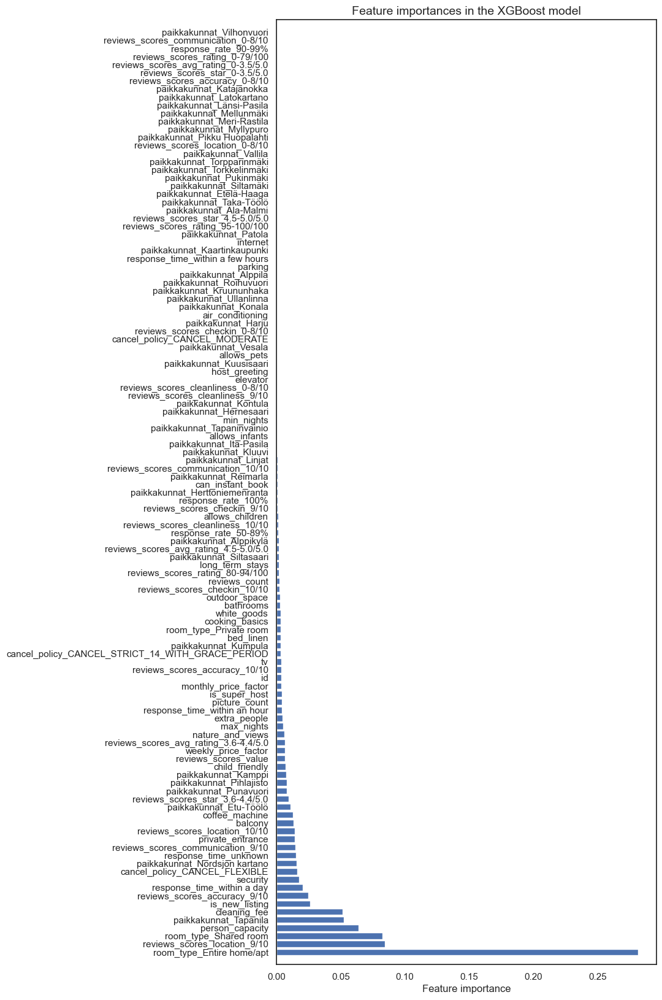

In [323]:
plt.figure(figsize=(8,20))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.title("Feature importances in the XGBoost model", fontsize=14)
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()

In [ ]:
#y_train

In [438]:
#X_train

## L. Lewis, xgb

In [ ]:
xgb_reg_start = time.time()

xgb_reg_l = xgb.XGBRegressor()
xgb_reg_l.fit(X_train, y_train)
training_preds_xgb_reg = xgb_reg_l.predict(X_train)
val_preds_xgb_reg = xgb_reg_l.predict(X_test)

xgb_reg_end = time.time()

print(f"Time taken to run: {round((xgb_reg_end - xgb_reg_start)/60,1)} minutes")
print("\nTraining MSE:", round(mean_squared_error(y_train, training_preds_xgb_reg),4))
print("Validation MSE:", round(mean_squared_error(y_test, val_preds_xgb_reg),4))
print("\nTraining r2:", round(r2_score(y_train, training_preds_xgb_reg),4))
print("Validation r2:", round(r2_score(y_test, val_preds_xgb_reg),4))

In [ ]:
ft_weights_xgb_reg = pd.DataFrame(xgb_reg_l.feature_importances_, columns=['weight'], index=X_train.columns)
ft_weights_xgb_reg.sort_values('weight', inplace=True)
ft_weights_xgb_reg.tail(20)




In [ ]:
# Plotting feature importances
plt.figure(figsize=(8,20))
plt.barh(ft_weights_xgb_reg.index, ft_weights_xgb_reg.weight, align='center') 
plt.title("Feature importances in the XGBoost model", fontsize=14)
plt.xlabel("Feature importance")
plt.margins(y=0.01)
plt.show()

In [ ]:
import pickle
file_xgboost_l = "xgb_reg_l.pkl"
pickle.dump(xgb_reg_l, open(file_xgboost_l, "wb"))

In [ ]:
# Separating X and y
#X = transformed_df.drop('price_string', axis=1)
#y = transformed_df.price_string

# Scaling
#scaler = StandardScaler()
#X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))


X = transformed_df[transformed_df.columns[transformed_df.columns.isin(['room_type', 'reviews_scores_location', 'person_capacity', 'cleaning_fee', 'is_new_listing' ,'reviews_scores_accuracy', 'balcony', 'paikkakunnat', 'nature_and_views', 'coffee_machine'] )]]
y = transformed_df.price_string
scaler = StandardScaler()
X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

#['room_type', 'reviews_scores_location', 'person_capacity', 'cleaning_fee', 'is_new_listing' ,'reviews_scores_accuracy', 'balcony']

In [ ]:
# Splitting into train and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=123)

In [ ]:
xgb_reg_start = time.time()

xgb_reg_l2 = xgb.XGBRegressor()
xgb_reg_l2.fit(X_train, y_train)
training_preds_xgb_reg = xgb_reg_l2.predict(X_train)
val_preds_xgb_reg = xgb_reg_l2.predict(X_test)

xgb_reg_end = time.time()

print(f"Time taken to run: {round((xgb_reg_end - xgb_reg_start)/60,1)} minutes")
print("\nTraining MSE:", round(mean_squared_error(y_train, training_preds_xgb_reg),4))
print("Validation MSE:", round(mean_squared_error(y_test, val_preds_xgb_reg),4))
print("\nTraining r2:", round(r2_score(y_train, training_preds_xgb_reg),4))
print("Validation r2:", round(r2_score(y_test, val_preds_xgb_reg),4))

In [ ]:

def nn_model_evaluation(model, skip_epochs=0, X_train=X_train, X_test=X_test, y_train=y_train, y_test=y_test):
    """
    For a given neural network model that has already been fit, prints for the train and tests sets the MSE and r squared
    values, a line graph of the loss in each epoch, and a scatterplot of predicted vs. actual values with a line
    representing where predicted = actual values. Optionally, a value for skip_epoch can be provided, which skips that
    number of epochs in the line graph of losses (useful in cases where the loss in the first epoch is orders of magnitude
    larger than subsequent epochs). Training and test sets can also optionally be specified.
    """

    # MSE and r squared values
    y_test_pred = model.predict(X_test)
    y_train_pred = model.predict(X_train)
    print("Training MSE:", round(mean_squared_error(y_train, y_train_pred),4))
    print("Validation MSE:", round(mean_squared_error(y_test, y_test_pred),4))
    print("\nTraining r2:", round(r2_score(y_train, y_train_pred),4))
    print("Validation r2:", round(r2_score(y_test, y_test_pred),4))
    
    # Line graph of losses
    model_results = model.history.history
    plt.plot(list(range((skip_epochs+1),len(model_results['loss'])+1)), model_results['loss'][skip_epochs:], label='Train')
    plt.plot(list(range((skip_epochs+1),len(model_results['val_loss'])+1)), model_results['val_loss'][skip_epochs:], label='Test', color='green')
    plt.legend()
    plt.title('Training and test loss at each epoch', fontsize=14)
    plt.show()
    
    # Scatterplot of predicted vs. actual values
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 4))
    fig.suptitle('Predicted vs. actual values', fontsize=14, y=1)
    plt.subplots_adjust(top=0.93, wspace=0)
    
    ax1.scatter(y_test, y_test_pred, s=2, alpha=0.7)
    ax1.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
    ax1.set_title('Test set')
    ax1.set_xlabel('Actual values')
    ax1.set_ylabel('Predicted values')
    
    ax2.scatter(y_train, y_train_pred, s=2, alpha=0.7)
    ax2.plot(list(range(2,8)), list(range(2,8)), color='black', linestyle='--')
    ax2.set_title('Train set')
    ax2.set_xlabel('Actual values')
    ax2.set_ylabel('')
    ax2.set_yticklabels(labels='')
    
    plt.show()

# Model 9

In [ ]:
all_review = list(X_train.columns[X_train.columns.str.startswith("review_scores")])
review_to_keep = list(X_train.columns[X_train.columns.str.startswith("reviews_scores_rating")])
review_to_drop = [x for x in all_review if x not in review_to_keep]

X_train_short = X_train.drop(review_to_drop, axis=1)
X_test_short = X_test.drop(review_to_drop, axis=1)

In [ ]:
# Dropping review columns from the original dataframe (after log transformation)
df_minmax = transformed_df.drop(review_to_drop, axis=1)

# Separating X and y
X_minmax = df_minmax.drop('price_string', axis=1)
y_minmax = df_minmax.price_string

# Scaling
scaler = MinMaxScaler(feature_range=(0, 1))
X_minmax = pd.DataFrame(scaler.fit_transform(X_minmax), columns=list(X_minmax.columns))

# Splitting into train and test sets
X_train_minmax, X_test_minmax, y_train_minmax, y_test_minmax = train_test_split(X_minmax, y_minmax, test_size=0.2, random_state=123)


In [ ]:
# Building the model
nn9 = models.Sequential()
nn9.add(layers.Dense(128, input_shape=(X_train_minmax.shape[1],), kernel_regularizer=regularizers.l1(0.005), activation='relu'))
nn9.add(layers.Dense(256, kernel_regularizer=regularizers.l1(0.005), activation='relu'))
nn9.add(layers.Dense(256, kernel_regularizer=regularizers.l1(0.005), activation='relu'))
nn9.add(layers.Dense(512, kernel_regularizer=regularizers.l1(0.005), activation='relu'))
nn9.add(layers.Dense(1024, kernel_regularizer=regularizers.l1(0.005), activation='relu'))
nn9.add(layers.Dense(1, activation='linear'))

# Compiling the model
nn9.compile(loss='mean_squared_error',
            optimizer='adam',
            metrics=['mean_squared_error'])

# Model summary
print(nn9.summary())

# Visualising the neural network
SVG(model_to_dot(nn9, show_layer_names=False, show_shapes=True).create(prog='dot', format='svg'))

In [ ]:
# Training the model
nn9_start = time.time()

nn9_history = nn9.fit(X_train_minmax,
                  y_train_minmax,
                  epochs=80,
                  batch_size=256,
                  validation_split = 0.1)

nn9_end = time.time()

print(f"Time taken to run: {round((nn9_end - nn9_start)/60,1)} minutes")

In [ ]:
nn_model_evaluation(nn9, skip_epochs=4, X_train=X_train_minmax, X_test=X_test_minmax, y_train=y_train_minmax, y_test=y_test_minmax)

In [ ]:
nn9_model = "nn9_model_minmax.pkl"
pickle.dump(nn9, open(nn9_model, "wb"))

In [ ]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
# create df
train = pd.read_csv('titanic.csv') # change file path
# drop null values
train.dropna(inplace=True)
# features and target
target = 'Survived'
features = ['Pclass', 'Age', 'SibSp', 'Fare']
# X matrix, y vector
X = train[features]
y = train[target]
# model 
model = LogisticRegression()
model.fit(X, y)
model.score(X, y)

In [ ]:
import numpy as np
from sklearn                        import metrics, svm
from sklearn.linear_model           import LogisticRegression
from sklearn import preprocessing
from sklearn import utils

In [ ]:
lab_enc = preprocessing.LabelEncoder()

In [ ]:
encoded = lab_enc.fit_transform(transformed_df['price_string'])

In [ ]:
import pandas as pd
from sklearn.linear_model import LogisticRegression
# create df
train = transformed_df
#train = transformed_df.drop('price_string', axis=1)


In [ ]:
import pandas as pd
from sklearn.linear_model import LogisticRegression

In [ ]:
train.dropna(inplace=True)

In [ ]:
target = 'price_string'

In [ ]:
train2.columns

In [ ]:
#train2.drop(['price_string'], axis=1)

In [ ]:
features = transformed_df.columns.drop(['price_string']).tolist()

In [ ]:
features

In [ ]:
features = ['allows_children', 'can_instant_book']


### Casting allows_children to int64 from float64 for the following logistic regression

In [ ]:
train['allows_children'] = train.allows_children.astype('int64')

In [ ]:
target = 'price_string'

In [ ]:
X = train[numerical_columns]
y = train[target]

In [ ]:
model = LogisticRegression()

In [ ]:
model.fit(X, y)

In [ ]:
train[features].head()

In [ ]:
y = np.log1p(transformed_df.price_string.values)

In [ ]:
model = LogisticRegression()

In [ ]:
model.fit(X, y)

In [ ]:
X = transformed_df.drop('price_string', axis=1)
y = transformed_df.price_string
X.dropna(inplace=True)

In [ ]:
model.fit(X, y)

In [ ]:
transformed2 = transformed_df
transformed2.dropna(inplace=True)

In [ ]:
numerical_columns = [i for i in numerical_columns if i not in ['availability_90', 'host_days_active']] # Removing items not to be transformed

for col in numerical_columns:
    transformed2[col] = transformed2[col].astype('float64').replace(0.0, 0.01) # Replacing 0s with 0.01
    transformed2[col] = np.log(transformed2[col])
    
X = transformed2.drop('price_string', axis=1)
y = transformed2.price_string


scaler = StandardScaler()
#X = pd.DataFrame(scaler.fit_transform(X), columns=list(X.columns))

In [ ]:
y = transformed2.price_string.values

In [ ]:
y = np.log(y)

In [ ]:
model.fit(X, y)

In [ ]:
seed = 7
test_size = 0.33
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=seed)

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=test_size, random_state=seed)

In [ ]:
df3 = df.drop(['id'], axis=1)

In [ ]:
X = df3.drop('price_string', axis=1)

In [ ]:
y = np.log1p(df3.price_string.values)

In [ ]:
from sklearn.preprocessing import OneHotEncoder

# Toimiva hintaennuste xgboostilla.

In [24]:
transformed_hel = pd.read_csv('data/hy-transformeddf.csv', index_col=0)

In [25]:
train = transformed_hel[['price_string', 'person_capacity', 'cleaning_fee', 'security']]

In [26]:
features = ['person_capacity', 'cleaning_fee', 'security']

In [30]:
target = 'price_string'

In [31]:
X = train[features]
y = train[target]

In [32]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [33]:
import xgboost
xgb = xgboost.XGBRegressor(n_estimators=100, learning_rate=0.08, gamma=0, subsample=0.75,colsample_bytree=1, max_depth=7)
traindf, testdf = train_test_split(X_train, test_size = 0.2)
res=xgb.fit(X_train,y_train)

In [34]:
import joblib
joblib.dump(res, 'model_typistetty_hel.pkl')

['model_typistetty_hel.pkl']

In [35]:
cols = ['person_capacity', 'cleaning_fee', 'security']
joblib.dump(cols, "model_cols_typistetty_hel.pkl")

['model_cols_typistetty_hel.pkl']

Kun flask on päällä - saat päälle menemällä flask-kansioon ja tekemällä komennon "flask run" - voit lähettää pyynnön palvelimelle: curl -d '{"person_capacity": 3.0, "cleaning_fee":40.0, "security":150}' -H "Content-Type: application/json" -X POST http://localhost:5000/predict_hel_typistetty/

Tuloksena on hinta ennuste asunnosta, jonka hinnan määrittelyssä on käytetty em. ominaisuuksia